# Code to identify homologous ABC proteins from proteomes using HMM profiles from Pfam.
> written by Sri Srikant, 20200614 for FEBS review "Evolutionary history of ABC proteins", to be contributed to the Special issue of FEBS Letters

The goal of this notebook is to pull out the ABC proteins contained in the proteomes of selected species, align them and build trees for use in the review. It is going to be written in Python 2. I have obtained the HMM models of Pfam families that form the domains common in ABC proteins; use hmmsearch to identify ABC proteins from the proteomes of the selected species across the phylogenetic tree of life.

## Setup and importing the necessary packages

In [1]:
##Importing all the relevant libraries.
import sys
import os
os.environ['QT_QPA_PLATFORM']='offscreen'
from os import listdir
from os.path import isfile, join
import subprocess
import shlex
import unicodedata

import traceback
import re
import collections

from Bio import SeqIO
from Bio.SeqRecord import SeqRecord
from Bio.Seq import Seq
from Bio.Alphabet import IUPAC
from Bio import pairwise2
from collections import defaultdict

from Bio.SeqUtils.ProtParam import ProteinAnalysis
from Bio.Blast.Applications import NcbiblastxCommandline
from Bio.Blast.Applications import NcbiblastnCommandline
from Bio.Blast.Applications import NcbitblastnCommandline

from Bio import Phylo
from Bio.Phylo.Applications import FastTreeCommandline
from Bio.Phylo.Applications import PhymlCommandline
from Bio.Phylo.Applications import RaxmlCommandline
from Bio.Blast import NCBIXML
import xml.etree.ElementTree as ET

from ete3 import Tree, TreeStyle

#import dendropy
import numpy as np
import seaborn as sns
import pandas as pd
from pylab import *
import matplotlib.pyplot as plt

import csv
import math
import operator
import itertools
from operator import attrgetter
from pprint import pprint

data_dir = "../"

In [2]:
##These are Classes and Functions
###Not using this for now.
class Pipeline(object):
    def __init__(self, command):
        self.command = command
        self.command_list = self.command.split('|')
        self.output = None
        self.errors = None
        self.status = None
        self.result = None

    def run(self):
        process_list = list()
        previous_process = None
        for command in self.command_list:
            args = shlex.split(command)
            if previous_process is None:
                process = subprocess.Popen(args, stdout=subprocess.PIPE)
            else:
                process = subprocess.Popen(args,
                                           stdin=previous_process.stdout,
                                           stdout=subprocess.PIPE)
            process_list.append(process)
            previous_process = process
        last_process = process_list[-1]
        self.output, self.errors = last_process.communicate()
        self.status = last_process.returncode
        self.result = (0 == self.status)
        return self.result

####Replacing with the SeqRecord Class present in Bio.
# class FASTAStructureMinimal():
#     def __init__(self, id, seq, name, description):
#         self.id = id
#         self.seq = seq
#         self.name = name
#         self.description = description
        
###Functions to modify pandas dataframe
def insert_species_name(row):
    return row['sequence name'].split("|/|")[0]

####Functions to modify the pandas dataframe 'candidate_promoter_stats_frame'
def fimostats_insert_species_name(row):
    return row['PheromoneCandidateName'].split("|/|")[0]

def fimostats_insert_chr_id(row):
    return row['PheromoneCandidateName'].split("|/|")[1].split("||")[0]

def fimostats_insert_cys_pos(row):
    return int(row['PheromoneCandidateName'].split("|/|")[1].split("||")[1].split("[Translate:")[0].split("[")[-1].split("-")[-2])

def fimostats_insert_stop_pos(row):
    return int(row['PheromoneCandidateName'].split("|/|")[1].split("||")[1].split("[Translate:")[0].split("[")[-1].split("-")[-1].split("]")[0])

####Functions to modify the pandas dataframe 'final_candidates_scoring_frame'
def candidates_score_sum_motifs(row):
    return (row['#all_motif_sites'] + row['#pheroAct_motif_sites'] + row['#aSpec_motif_sites'])

In [3]:
##Defining directories to run code.
###When I make the functions to be used on Odyssey these have to be changed accordingly! Especially the genome_dir and the protein_dir are going to be made into static links.
###Remember to run the code block below before the "_Processed" folders show up.
hmm_dir = os.path.join(data_dir, "Pfam", "HMM_hmmbuild")
alignment_dir = os.path.join(data_dir, "Pfam", "SEED_alignments")
proteomes_dir = os.path.join(data_dir, "RefSeq", "Proteomes")
dictionary_dir = os.path.join(data_dir, "dictionary")
figure_dir = os.path.join(data_dir, "figures")

In [4]:
##Outputing contents of the dictionay directory.
fileList = [f for f in os.listdir(dictionary_dir) if f.endswith("csv")]
print("The dictionary files are:")
print("\n".join(fileList))

The dictionary files are:
20200614_ABC-domains_Pfam-details.csv
20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv
20200616_ABC-domains_PfamMinimal-details.csv


## Validating the proteome FASTA files of the species and HMM of the Pfam domains with the corresponding dictionary files.
The following code-cells are writted to perform the following functions:
1. Function to read in the proteome files and pre-pend the species name to each proteins' ID. Proteomes are one isoform per ORF dropping alternate splicing variants.
2. Function to organize the HMMs of Pfam domains associated with ABC proteins.

In [5]:
###Read in the dictionary of the Proteome files.
species_proteome_dictionary_frame = pd.read_csv(os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv"), sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)
#species_proteome_dictionary_frame['Species'].str.replace('\\xa0',' ')
print("\t".join(["The number of species considered here are:", str(len(species_proteome_dictionary_frame))]))
print(species_proteome_dictionary_frame.columns.values)
print(species_proteome_dictionary_frame['Species'].values)
species_proteome_dictionary_frame.head()

The number of species considered here are:	68
['Species' 'Common name' 'Comments' '#proteins' 'Phylogenetic group'
 'Proteome ID' 'BUSCO completeness' 'Link']
['Escherichia coli' 'Haemophilus influenzae' 'Vibrio cholerae'
 'Pseudomonas aeruginosa' 'Myxococcus stipitatus'
 'Mycobacterium tuberculosis' 'Streptomyces coelicolor'
 'Corynebacterium glutamicum' 'Thermobispora bispora' 'Bacillus subtilis'
 'Lactobacillus plantarum' 'Listeria monocytogenes'
 'Streptococcus pneumoniae' 'Lactococcus lactis subsp. lactis'
 'Enterococcus faecalis' 'Staphylococcus aureus'
 'Bacteroides thetaiotaomicron' 'Flavobacterium psychrophilum'
 'Salinibacter ruber' 'Synechocystis sp.' 'Prochlorococcus marinus'
 'Gloeobacter violaceus' 'Saccharolobus solfataricus' 'Haloferax volcanii'
 'Dictyostelium discoideum' 'Paramecium tetraurelia'
 'Tetrahymena thermophila' 'Trypanosoma cruzi' 'Chlamydomonas reinhardtii'
 'Volvox carteri f. nagariensis' 'Chlorella variabilis'
 'Ectocarpus siliculosus' 'Porphyridium purp

,Species,Common name,Comments,#proteins,Phylogenetic group,Proteome ID,BUSCO completeness,Link
0,Escherichia coli,K12,Standard,"4,391",Gammaproteobacteria,UP000000625,"C:100%[S:99.9%,D:0.1%],F:0%,M:0%,n:781",https://www.uniprot.org/proteomes/UP000000625
1,Haemophilus influenzae,ATCC 51907 / DSM 11121 / KW20 / Rd,Standard,"1,706",Gammaproteobacteria,UP000000579,"C:95.6%[S:94.9%,D:0.7%],F:0.7%,M:3.8%,n:452",https://www.uniprot.org/proteomes/UP000000579
2,Vibrio cholerae,serotype O1 / ATCC 39315 / El Tor Inaba N16961,Standard,"3,782",Gammaproteobacteria,UP000000584,"C:98.9%[S:98.5%,D:0.4%],F:0%,M:1.1%,n:452",https://www.uniprot.org/proteomes/UP000000584
3,Pseudomonas aeruginosa,PAO1 / ATCC 15692 / DSM 22644 / CIP 104116 / J...,Standard,"5,564",Gammaproteobacteria,UP000002438,"C:100%[S:99.3%,D:0.7%],F:0%,M:0%,n:452",https://www.uniprot.org/proteomes/UP000002438
4,Myxococcus stipitatus,DSM 14675 / JCM 12634 / Mx s8,Standard,"8,043",Proteobacteria,UP000011131,"C:92.9%[S:88.9%,D:4.1%],F:3.7%,M:3.4%,n:296",https://www.uniprot.org/proteomes/UP000011131


In [6]:
####Read in the dictionary of the HMM files.
hmm_dictionary_frame = pd.read_csv(os.path.join(dictionary_dir, "20200614_ABC-domains_Pfam-details.csv"), sep=",", index_col=False)
print("\t".join(["The number of Pfam domains considered here are:", str(len(hmm_dictionary_frame))]))
hmm_dictionary_frame.head()

The number of Pfam domains considered here are:	27


,Identifier,Type,Name,Common Name,#families,#architectures,#seqs,Seed #seq,#UniProt,Rep. species,Avg. domain len,Avg. ID,Avg. coverage,HMM length,HMM ver,#structures,Link
0,PF00005,Family,ABC_tran,NBD domains,23.70%,2364,676776,55,2805253,7942,148.9,0.26,0.3767,137,28,915,https://pfam.xfam.org/family/PF00005
1,PF12848,Family,ABC_tran_Xtn,NaN,0.90%,75,24310,148,104145,7461,85.7,0.22,0.1438,85,8,6,https://pfam.xfam.org/family/PF12848
2,PF09818,Family,ABC_ATPase,NaN,0.00%,3,859,31,3086,793,417.8,0.44,0.7631,448,10,5,https://pfam.xfam.org/family/PF09818
3,PF00664,Family,ABC_membrane,"B,C,D-family",95.50%,732,120687,70,384238,7753,262.7,0.14,0.4038,274,24,382,https://pfam.xfam.org/family/PF00664
4,PF06472,Family,ABC_membrane_2,NaN,4.20%,59,5264,25,15713,2075,255.1,0.26,0.4001,269,16,2,https://pfam.xfam.org/family/PF06472


In [7]:
####Read in the dictionary of the HMM files.
hmm_dictionary_frame = pd.read_csv(os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv"), sep=",", index_col=False)
print("\t".join(["The number of Pfam domains considered here are:", str(len(hmm_dictionary_frame))]))
hmm_dictionary_frame.head(10)

The number of Pfam domains considered here are:	10


,Identifier,Type,Name,Common Name,#families,#architectures,#seqs,Seed #seq,#UniProt,Rep. species,Avg. domain len,Avg. ID,Avg. coverage,HMM length,HMM ver,#structures,Link
0,PF00005,Family,ABC_tran,NBD domains,23.70%,2364,676776,55,2805253,7942,148.9,0.26,0.3767,137,28,915,https://pfam.xfam.org/family/PF00005
1,PF00664,Family,ABC_membrane,"B,C,D-family",95.50%,732,120687,70,384238,7753,262.7,0.14,0.4038,274,24,382,https://pfam.xfam.org/family/PF00664
2,PF01061,Family,ABC2_membrane,"G-family (G2,G5,G8, O-antigen polysacch transp...",41.90%,691,54964,221,148374,7022,205.6,0.16,0.4049,210,25,25,https://pfam.xfam.org/family/PF01061
3,PF12698,Family,ABC2_membrane_3,A-family (A1),20.30%,176,26572,138,101533,6223,335.7,0.11,0.5241,345,8,5,https://pfam.xfam.org/family/PF12698
4,PF19055,Family,ABC2_membrane_7,NaN,14.40%,448,18926,41,29987,1176,114.0,0.27,0.1266,409,1,20,https://pfam.xfam.org/family/PF19055
5,PF06422,Family,PDR_CDR,NaN,4.50%,197,5873,446,9368,650,85.3,0.29,0.0682,92,13,0,https://pfam.xfam.org/family/PF06422
6,PF00528,Family,BPD_transp_1,MalEFGK,82.30%,206,288114,81,1302696,6591,197.6,0.15,0.6538,185,23,73,http://pfam.xfam.org/family/PF00528
7,PF02687,NaN,FtsX,MacA,14.50%,69,50016,81,243333,6633,95.9,0.20,0.1962,96,22,15,http://pfam.xfam.org/family/PF02687
8,PF02653,Family,BPD_transp_2,"BtuCD, branched-chain aa transporters",55.80%,64,71974,29,337046,5119,279.3,0.19,0.7987,270,17,0,http://pfam.xfam.org/family/PF02653
9,PF01032,Family,FecCD,NaN,18.00%,24,23209,102,114710,5570,307.6,0.29,0.9172,312,19,20,http://pfam.xfam.org/family/PF01032


In [8]:
####Generate file list of the proteomes of the species considered here.
proteome_filelist = [f for f in os.listdir(proteomes_dir) if f.endswith("fasta")]
print("\t".join(["The number of proteomes considered here are:", str(len(proteome_filelist))]))

proteome_list = [f.split("_")[0] for f in os.listdir(proteomes_dir) if f.endswith("fasta")]
print(" ".join(["The proteomes missing from the", proteomes_dir, "but present in the species list dataframe:"]))
print(np.setdiff1d(species_proteome_dictionary_frame['Proteome ID'].values, proteome_list))

The number of proteomes considered here are:	68
The proteomes missing from the ../RefSeq/Proteomes but present in the species list dataframe:
[]


In [30]:
##Code cell to modify the proteomes to include the species name in the sequence IDs and save to a new folder.
###Input variables:
    ###proteomes_dir = Directory containing all proteomes directly obtained from UniProt. FASTA files are named {'Proteome ID'_*.fasta} as listed in the dataframe.
    ###dictionary_dir = Directory containing all the dictionary CSV files made to annotate the files I have.
proteomes_dir = os.path.join(data_dir, "RefSeq", "Proteomes")
dictionary_dir = os.path.join(data_dir, "dictionary")

####Making the output directory for the processed proteomes.
refseq_dir = "/".join(proteomes_dir.split("/")[:-1])
#print(refseq_dir)

####Parsing the CSV of the species list to use as a dictionary.
species_proteome_dictionary_frame = pd.read_csv(os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv"), sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)
print("\t".join(["The number of species considered here are:", str(len(species_proteome_dictionary_frame))]))
print("The columns present in the speciesList dataframe are:")
print(species_proteome_dictionary_frame.columns.values)
print("-----\n")

####Making output directory.
if not(os.path.isdir(os.path.join(refseq_dir, proteomes_dir.split("/")[-1]+"_Processed"))):
    os.mkdir(os.path.join(refseq_dir, proteomes_dir.split("/")[-1]+"_Processed"))

####Looping through all proteomes in the proteome directory.
proteome_filelist = [f for f in os.listdir(proteomes_dir) if f.endswith("fasta")]
for proteome_file in proteome_filelist:
    ####Opening proteome FASTA file.
    input_handle = open(os.path.join(proteomes_dir, proteome_file), "r")
    proteome = list(SeqIO.parse(input_handle, "fasta"))
    input_handle.close()
    
    #print(str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome_file.split("_")[0]]['Species'].iloc[0]).replace(" ", "_"))
    print(" ".join(["Proteome of", str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome_file.split("_")[0]]['Species'].iloc[0]),
                    "contains", str(len(proteome)), "proteins!"]))
    
    modified_proteome = []
    ####Looping through proteome SeqIO records and modifying the ID of each record.
    for protein in proteome:
        #print(protein)
        #print(protein.id)
        #print(protein.description.replace(protein.id+" ", ""))
        
        modified_proteome.append(SeqRecord(protein.seq, 
                                           id="|/|".join([str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome_file.split("_")[0]]['Species'].iloc[0]).replace(" ", "_"), protein.id]),
                                           name=protein.name, description=protein.description.replace(protein.id+" ", "")))
#         modified_proteome.append(FASTAStructureMinimal("|/|".join([str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome_file.split("_")[0]]['Species'].iloc[0]).replace(" ", "_"), protein.id]),
#                                                        protein.seq, protein.name, protein.description))
    #print(modified_proteome[0])
    
    ####Output to proteome file of the same name in the "_Processed directory"
    print("\t".join(["Species:", str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome_file.split("_")[0]]['Species'].iloc[0])]))
    print("\t".join(["Output file:", os.path.join(refseq_dir, proteomes_dir.split("/")[-1]+"_Processed", proteome_file)]))
    print("\n")
    with open(os.path.join(refseq_dir, proteomes_dir.split("/")[-1]+"_Processed", proteome_file), "w") as output_handle:
        SeqIO.write(modified_proteome, output_handle, "fasta")
    #sys.exit()

The number of species considered here are:	68
The columns present in the speciesList dataframe are:
['Species' 'Common name' 'Comments' '#proteins' 'Phylogenetic group'
 'Proteome ID' 'BUSCO completeness' 'Link']
-----

Proteome of Camponotus floridanus contains 14787 proteins!
Species:	Camponotus floridanus
Output file:	../RefSeq/Proteomes_Processed/UP000000311_104421.fasta


Proteome of Lactobacillus plantarum contains 3087 proteins!
Species:	Lactobacillus plantarum
Output file:	../RefSeq/Proteomes_Processed/UP000000432_220668.fasta


Proteome of Danio rerio contains 25706 proteins!
Species:	Danio rerio
Output file:	../RefSeq/Proteomes_Processed/UP000000437_7955.fasta


Proteome of Gallus gallus contains 18118 proteins!
Species:	Gallus gallus
Output file:	../RefSeq/Proteomes_Processed/UP000000539_9031.fasta


Proteome of Gloeobacter violaceus contains 4406 proteins!
Species:	Gloeobacter violaceus
Output file:	../RefSeq/Proteomes_Processed/UP000000557_251221.fasta


Proteome of Ustila

In [66]:
##Function to read through the HMM as listed in the HMM dictionary and confirm all HMMs are accounted for. I am then going to extract all the domain hits for analysis.
##I need to add the domain position in the overall sequence to the sequence ID so that I can use this for subsequent analysis.
###Input variables:
    ###proteomes_processed_dir = Directory containing the processed FASTA files of all the species proteomes. To be searched.
    ###hmm_dir = Directory containing all the HMM of the Pfam domains to be found.
    ###hmm_dictionary_file = CSV file with details of the Pfam family, name of hmm is {'Name'}.hmm as listed in the dataframe.
proteomes_processed_dir = os.path.join(refseq_dir, proteomes_dir.split("/")[-1]+"_Processed")
if not(os.path.isdir(proteomes_processed_dir)):
    print(["\t".join(["Please run code cell above to modify proteomes with species name and generate the 'Processed' directory of FASTA files at:", proteomes_processed_dir])])
    sys.exit()

hmm_dir = os.path.join(data_dir, "Pfam", "HMM_hmmbuild")
hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)
print("Columns in HMM dictionary frame are:")
#print(hmm_dictionary_frame.columns.values)
print("The Pfam families that I am going to find are:")
print(hmm_dictionary_frame['Name'].values)
print("----\n")

####Parse through the hmm_dictionary_frame and confirm the presence of all the necessary {.hmm} models in the hmm_dir.
count_check = 0
for index, row in hmm_dictionary_frame.iterrows():
    if os.path.isfile(os.path.join(hmm_dir, str(row['Name'])+".hmm")):
        count_check += 1
    else:
        print(" ".join(["The HMM file for", str(row['Name']), "is missing!"]))
print(" ".join(["Found", str(count_check), "of", str(len(hmm_dictionary_frame['Name'].values)), "HMM files of Pfam domains!"]))

Columns in HMM dictionary frame are:
The Pfam families that I am going to find are:
['ABC_tran' 'ABC_membrane' 'ABC2_membrane' 'ABC2_membrane_3'
 'ABC2_membrane_7' 'PDR_CDR' 'BPD_transp_1' 'FtsX' 'BPD_transp_2' 'FecCD']
----

Found 10 of 10 HMM files of Pfam domains!


### Results of the file-checks ni order to run the analysis
1. Modified proteomes of species to prepend species name to ID of every protein and saved as modified FASTA files to new directory. Specifically changed to using the Bio.SeqRecord.SeqRecord class instead of the FASTAStructureMinimal class I made. This lets me take advantage of all the features Biopython provides including SeqIO and functions on Seq objects.
    1. On [200623], I realized that SeqRecord.description includes the SeqRecord.id, so I decided to output to the next description including .replace("protein.id+" ",""). I need to re-run everything below. I've made tarballs of the old runs of "hmmsearch", "hmmalign" and "fasttree" runs.
2. Validated the presence of all the hmm I need in the hmm_dir. I have decided to use a minimal set of Pfam domains by dropping the families that are not populated with a lot of sequences. This gives me 10 (instead of 28) families to consider.

## Running hmmsearch to find all occurences of the required domains in the proteomes
Functions in this code block:
1. Function to run 'hmmsearch' on all the proteomes with the HMMs validated in the code-cells above.
2. Function to run 'esl-sfetch --index' on the processed proteomes directory.
3. Function to use 'esl-sfetch' to extract entire proteins that contain hits to Pfam HMMs and output single FASTA files grouped by species.
4. Function to use 'esl-sfetch' to extract entire proteins that contain hits to Pfam HMMs and output single FASTA files grouped by Pfam domain searched for.
5. Function to use 'esl-sfetch' to extract the protein fragments homologous to the domains searched for.
    1. All domains without filtering based on annotation
    2. Domains from proteins that are filtered based on annotation as being ATP-binding or involved in transport.
    3. Domains from proteins that are filtered based on annotation and also are atleast as long as 0.9*length of the HMM profile from Pfam.

In [31]:
##Function to run hmmsearch on all the modified proteomes with the HMMs I have validated.
##Including the '-A' option in hmmsearch that outputs the STOCKHOLM alignment of domain hits and '--domtblout' option for tabulation of all domain hits.
##Including 'incE' option to set the e-value threshold for the search, and in particular I am going to 
###Input variables:
    ###proteomes_processed_dir = Directory containing the processed FASTA files of all the species proteomes. Proteome files names are {'Proteome ID'_*.fasta} as in the dataframe.
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dir = Directory containing all the HMM of the Pfam domains to be found. HMM file names are {'Name'.hmm} as in the dataframe.
    ###hmm_dictionary_file = CSV file with details of the Pfam family

proteomes_processed_dir = os.path.join(data_dir, "RefSeq", proteomes_dir.split("/")[-1]+"_Processed")
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dir = os.path.join(data_dir, "Pfam", "HMM_hmmbuild")
hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

####Making output directory for the extracted ABC proteins.
if not(os.path.isdir(os.path.join(data_dir, "hmmsearch"))):
    os.mkdir(os.path.join(data_dir, "hmmsearch"))
if not(os.path.isdir(os.path.join(data_dir, "hmmsearch", "hmmsearch_raw"))):
    os.mkdir(os.path.join(data_dir, "hmmsearch", "hmmsearch_raw"))

####Building file list of the proteomes to be searched.
proteome_filelist = [f for f in os.listdir(proteomes_processed_dir) if f.endswith(".fasta")]
search_count = 0
for proteome_file in proteome_filelist:
    print("\n\t".join(["Running searches on:",
                     str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome_file.split("_")[0]]['Species'].iloc[0]),
                     proteome_file]))
    for index, record in hmm_dictionary_frame.iterrows():
        input_proteome_file = os.path.join(proteomes_processed_dir, proteome_file)
        hmm_file = os.path.join(hmm_dir, str(record['Name'])+".hmm")
        
        print("\n\t".join(["Running hmmsearch with:", hmm_file]))
        hmmsearch_output_file = os.path.join(data_dir, "hmmsearch", "hmmsearch_raw", str(record['Name'])+"_0_"+proteome_file.split("_")[0]+"_hmmsearch.out")
        hmmsearch_output_alignment = os.path.join(data_dir, "hmmsearch", "hmmsearch_raw", str(record['Name'])+"_0_"+proteome_file.split("_")[0]+"_hmmsearch.sto")
        hmmsearch_output_tblout = os.path.join(data_dir, "hmmsearch", "hmmsearch_raw", str(record['Name'])+"_0_"+proteome_file.split("_")[0]+"_hmmsearch.tbl")
        hmmsearch_output_domtblout = os.path.join(data_dir, "hmmsearch", "hmmsearch_raw", str(record['Name'])+"_0_"+proteome_file.split("_")[0]+"_hmmsearch.domtbl")
        
        hmmsearch_cmd = subprocess.call(["hmmsearch", "-A", hmmsearch_output_alignment,
                                         "-o", hmmsearch_output_file,
                                         "--tblout", hmmsearch_output_tblout,
                                         "--domtblout", hmmsearch_output_domtblout, 
                                         "--incE", "0.001", 
                                         hmm_file, input_proteome_file])
        search_count += 1
    print("----\n")
print(" ".join(["Completed", str(search_count), "hmmsearch runs for ABC domains on proteomes!"]))

Running searches on:
	Camponotus floridanus
	UP000000311_104421.fasta
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/ABC_tran.hmm
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/ABC_membrane.hmm
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/ABC2_membrane.hmm
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/ABC2_membrane_3.hmm
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/ABC2_membrane_7.hmm
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/PDR_CDR.hmm
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/BPD_transp_1.hmm
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/FtsX.hmm
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/BPD_transp_2.hmm
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/FecCD.hmm
----

Running searches on:
	Lactobacillus plantarum
	UP000000432_220668.fasta
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/ABC_tran.hmm
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/ABC_membrane.hmm
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/ABC2_membrane.hmm
Running hmmsearch with:
	../Pfam/HMM_hmmbuild/ABC2_me

In [32]:
##Running esl-fetch index on the Proteomes_Processes.
###Input variables:
    ###proteomes_processed_dir = Directory containing the processed FASTA files of all the species proteomes. Proteome files names are {'Proteome ID'_*.fasta} as in the dataframe.
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
proteomes_processed_dir = os.path.join(data_dir, "RefSeq", proteomes_dir.split("/")[-1]+"_Processed")
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

####Building file list of the proteomes to be searched.
proteome_filelist = [f for f in os.listdir(proteomes_processed_dir) if f.endswith(".fasta")]
for proteome in proteome_filelist:
    eslsfetch_index_cmd = subprocess.call(["esl-sfetch", "--index", os.path.join(proteomes_processed_dir, proteome)])
    print("\t".join(["Indexing proteome files in order to extract the results from hmmsearch by esl-fetch:", os.path.join(proteomes_processed_dir, proteome)]))

Indexing proteome files in order to extract the results from hmmsearch by esl-fetch:	../RefSeq/Proteomes_Processed/UP000000311_104421.fasta
Indexing proteome files in order to extract the results from hmmsearch by esl-fetch:	../RefSeq/Proteomes_Processed/UP000000432_220668.fasta
Indexing proteome files in order to extract the results from hmmsearch by esl-fetch:	../RefSeq/Proteomes_Processed/UP000000437_7955.fasta
Indexing proteome files in order to extract the results from hmmsearch by esl-fetch:	../RefSeq/Proteomes_Processed/UP000000539_9031.fasta
Indexing proteome files in order to extract the results from hmmsearch by esl-fetch:	../RefSeq/Proteomes_Processed/UP000000557_251221.fasta
Indexing proteome files in order to extract the results from hmmsearch by esl-fetch:	../RefSeq/Proteomes_Processed/UP000000561_237631.fasta
Indexing proteome files in order to extract the results from hmmsearch by esl-fetch:	../RefSeq/Proteomes_Processed/UP000000579_71421.fasta
Indexing proteome files i

In [35]:
##Function to extract all hmmsearch hits as full proteins from the hmmsearch runs above.
##The results are going to be grouped by species, and as full protein sequences.
##Leaving this out for now since I am worried about missing hits. ##I am going to choose proteims by the presence of 'ATP-binding', 'Multidrug' & 'ABC' in the descriptions.
    ###proteomes_processed_dir = Directory containing the processed FASTA files of all the species proteomes. Proteome files names are {'Proteome ID'_*.fasta} as in the dataframe.
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dir = Directory containing all the HMM of the Pfam domains to be found. HMM file names are {'Name'.hmm} as in the dataframe.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmsearch_raw_dir = Directory of hmmsearch outputs. 'esl-sfetch' to extract full sequences uses the tabular output of hits {*.tbl} file.
proteomes_processed_dir = os.path.join(data_dir, "RefSeq", proteomes_dir.split("/")[-1]+"_Processed")
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

hmmsearch_raw_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_raw")

####Making output directory for the extracted ABC proteins.
if not(os.path.isdir(os.path.join(data_dir, "hmmsearch"))):
    os.mkdir(os.path.join(data_dir, "hmmsearch"))
if not(os.path.isdir(os.path.join(data_dir, "hmmsearch", "hmmsearch_prot_by-species"))):
    os.mkdir(os.path.join(data_dir, "hmmsearch", "hmmsearch_prot_by-species"))
hmmsearch_byspecies_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_prot_by-species")

####Building file list of the proteomes to be searched.
full_homolog_protein_collection = []
proteome_filelist = [f for f in os.listdir(proteomes_processed_dir) if f.endswith(".fasta")]
for proteome in proteome_filelist:
    input_prot_database = os.path.join(proteomes_processed_dir, proteome)
    print("\t".join(["Working on finding ABC genes in the proteome of", 
                     str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome.split("_")[0]]['Species'].iloc[0]), 
                     proteome.split("_")[0]]))
    
    homolog_protein_collection = []
    protein_hits_list = []
    protein_search_set = set(protein_hits_list)
    for index, record in hmm_dictionary_frame.iterrows():
        hmmsearch_output_tblout = os.path.join(hmmsearch_raw_dir, str(record['Name'])+"_0_"+proteome.split("_")[0]+"_hmmsearch.tbl")
        temp_output_file = os.path.join(hmmsearch_byspecies_dir, "temp_0_"+proteome.split("_")[0]+".fasta")
        #temp = "grep -v \"^#\" "+hmmsearch_output_tblout+" | awk '{print $1}' | esl-sfetch"+" -f "+input_prot_database+" - > "+temp_output_file
        #eslsfetch_cmd = subprocess.call([temp])
                
        command = '|'.join([
            "grep -v \"^#\" "+hmmsearch_output_tblout,
            "awk '{print $1}'",
            "esl-sfetch -f "+input_prot_database+" - > "+temp_output_file
        ])
        #print command
        ##This works exactly as needed but python strongly discourages using shell=True since it is not secure. I am going to go ahead with this temporarily.
        eslsfetch_cmd = subprocess.call([command], shell=True)
        #pipeline = Pipeline(command)
        #if not pipeline.run():
        #    print "ERROR: Pipeline failed"
        #else:
        #    print pipeline.output
        #sys.exit()
        
        ##The next step is to open the results file and append the top hit to a class for all mating homologous genes into a single file. 
        ##I can then delete the temp file of the output file.
        input_temp_seq_file = temp_output_file
        input_handle = open(input_temp_seq_file, "r")
        temp_candidates = list(SeqIO.parse(input_handle, "fasta"))
        input_handle.close()
        
        #print(str(record['Name'])+"|/|"+temp_candidates[0].id+"\n"+temp_candidates[0].seq)
        hit_count = 0
        if not temp_candidates:
            print(" ".join(["No hits found for", str(record['Name']), "domain in", 
                            str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome.split("_")[0]]['Species'].iloc[0]), ". Skipping!"]))
        else:
            for temp_result in temp_candidates:
                if temp_result.id in protein_search_set:
                    print("\t".join(["Skipping duplicate hmmsearch hit:", temp_result.id]))
                else:
                    #if ((temp_result.description.count("ATP-binding") > 0) or (temp_result.description.count("Multidrug") > 0) or (temp_result.description.count("ABC") > 0)):
                    #print("\n".join([temp_result.id, temp_result.description, temp_result.description.replace(temp_result.id+" ","")]))
                    
                    homolog_protein_collection.append(SeqRecord(temp_result.seq, 
                                                                id="|/|".join([temp_result.id, str(record['Name'])]), 
                                                                name=temp_result.name, 
                                                                description=temp_result.description.replace(temp_result.id+" ","")))
                    protein_hits_list.append(temp_result.id)
                    protein_search_set = set(protein_hits_list)
                    hit_count += 1            
            
            print(" ".join(["Hits found for", str(record['Name']), "in", 
                            str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome.split("_")[0]]['Species'].iloc[0]), 
                            ", and", str(hit_count), "unique hits saved!"]))
        os.remove(temp_output_file)
    
    print(" ".join([str(len(homolog_protein_collection)), "proteins containing Pfam ABC domains in", 
                    str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome.split("_")[0]]['Species'].iloc[0]), ". Good luck!\n"]))
#     for homolog in homolog_protein_collection:
#         print("\t"+homolog.id.split("|/|")[0])
    
    ####Outputing FASTA file containing all unique proteins with Pfam ABC domains from each species.
    homolog_byspecies_output_fasta_file = os.path.join(hmmsearch_byspecies_dir, proteome.split("_")[0]+"_hmmsearch_by-species_prot.fasta")
    with open(homolog_byspecies_output_fasta_file, "w") as output_handle:
        SeqIO.write(homolog_protein_collection, output_handle, "fasta")
    
    full_homolog_protein_collection = full_homolog_protein_collection + homolog_protein_collection

####Outputing FASTA file containing all unique proteins with Pfam ABC domains from all species.
homolog_output_fasta_file = os.path.join(hmmsearch_byspecies_dir, "ABC-Pfam-hmmsearch_all-species_prot.fasta")
with open(homolog_output_fasta_file, "w") as output_handle:
    SeqIO.write(homolog_protein_collection, output_handle, "fasta")

Working on finding ABC genes in the proteome of	Camponotus floridanus	UP000000311
Hits found for ABC_tran in Camponotus floridanus , and 124 unique hits saved!
Skipping duplicate hmmsearch hit:	Camponotus_floridanus|/|tr|E2AWB0|E2AWB0_CAMFO
Skipping duplicate hmmsearch hit:	Camponotus_floridanus|/|tr|E2AUW0|E2AUW0_CAMFO
Skipping duplicate hmmsearch hit:	Camponotus_floridanus|/|tr|E2B0Q4|E2B0Q4_CAMFO
Skipping duplicate hmmsearch hit:	Camponotus_floridanus|/|tr|E1ZWK6|E1ZWK6_CAMFO
Skipping duplicate hmmsearch hit:	Camponotus_floridanus|/|tr|E2AJR5|E2AJR5_CAMFO
Skipping duplicate hmmsearch hit:	Camponotus_floridanus|/|tr|E2A9S6|E2A9S6_CAMFO
Skipping duplicate hmmsearch hit:	Camponotus_floridanus|/|tr|E2AJR6|E2AJR6_CAMFO
Skipping duplicate hmmsearch hit:	Camponotus_floridanus|/|tr|E2AD78|E2AD78_CAMFO
Skipping duplicate hmmsearch hit:	Camponotus_floridanus|/|tr|E2AHJ1|E2AHJ1_CAMFO
Skipping duplicate hmmsearch hit:	Camponotus_floridanus|/|tr|E2AJR7|E2AJR7_CAMFO
Skipping duplicate hmmsearch h

In [36]:
##Function to extract all hmmsearch hits as full proteins from the hmmsearch runs above.
##The results are going to be grouped by domain, and as full protein sequences in order to build trees.
##Leaving this out for now since I am worried about missing hits. ##I am going to choose proteims by the presence of 'ATP-binding', 'Multidrug' & 'ABC' in the descriptions.
    ###proteomes_processed_dir = Directory containing the processed FASTA files of all the species proteomes. Proteome files names are {'Proteome ID'_*.fasta} as in the dataframe.
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dir = Directory containing all the HMM of the Pfam domains to be found. HMM file names are {'Name'.hmm} as in the dataframe.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmsearch_raw_dir = Directory of hmmsearch outputs. 'esl-sfetch' to extract full sequences uses the tabular output of hits {*.tbl} file.
proteomes_processed_dir = os.path.join(data_dir, "RefSeq", proteomes_dir.split("/")[-1]+"_Processed")
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

hmmsearch_raw_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_raw")

####Making output directory for the extracted ABC proteins.
if not(os.path.isdir(os.path.join(data_dir, "hmmsearch"))):
    os.mkdir(os.path.join(data_dir, "hmmsearch"))
if not(os.path.isdir(os.path.join(data_dir, "hmmsearch", "hmmsearch_prot_by-domain"))):
    os.mkdir(os.path.join(data_dir, "hmmsearch", "hmmsearch_prot_by-domain"))
hmmsearch_bydomain_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_prot_by-domain")

####Building file list of the proteomes to be searched.
full_homolog_protein_collection = []
proteome_filelist = [f for f in os.listdir(proteomes_processed_dir) if f.endswith(".fasta")]
for index, record in hmm_dictionary_frame.iterrows():
    print("\t".join(["Working on finding hits to HMM profile of", 
                         record['Name']]))
    
    homolog_protein_collection = []
    protein_hits_list = []
    protein_search_set = set(protein_hits_list)
    for proteome in proteome_filelist:
        input_prot_database = os.path.join(proteomes_processed_dir, proteome)
        hmmsearch_output_tblout = os.path.join(hmmsearch_raw_dir, str(record['Name'])+"_0_"+proteome.split("_")[0]+"_hmmsearch.tbl")
        temp_output_file = os.path.join(hmmsearch_bydomain_dir, "temp_0_"+proteome.split("_")[0]+".fasta")
        #temp = "grep -v \"^#\" "+hmmsearch_output_tblout+" | awk '{print $1}' | esl-sfetch"+" -f "+input_prot_database+" - > "+temp_output_file
        #eslsfetch_cmd = subprocess.call([temp])
                
        command = '|'.join([
            "grep -v \"^#\" "+hmmsearch_output_tblout,
            "awk '{print $1}'",
            "esl-sfetch -f "+input_prot_database+" - > "+temp_output_file
        ])
        #print command
        ##This works exactly as needed but python strongly discourages using shell=True since it is not secure. I am going to go ahead with this temporarily.
        eslsfetch_cmd = subprocess.call([command], shell=True)
        #pipeline = Pipeline(command)
        #if not pipeline.run():
        #    print "ERROR: Pipeline failed"
        #else:
        #    print pipeline.output
        #sys.exit()
        
        ##The next step is to open the results file and append the top hit to a class for all mating homologous genes into a single file. 
        ##I can then delete the temp file of the output file.
        input_temp_seq_file = temp_output_file
        input_handle = open(input_temp_seq_file, "r")
        temp_candidates = list(SeqIO.parse(input_handle, "fasta"))
        input_handle.close()
        
        #print(str(record['Name'])+"|/|"+temp_candidates[0].id+"\n"+temp_candidates[0].seq)
        hit_count = 0
        if not temp_candidates:
            print(" ".join(["No hits found for", str(record['Name']), "domain in", 
                            str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome.split("_")[0]]['Species'].iloc[0]), ". Skipping!"]))
        else:
            for temp_result in temp_candidates:
                if temp_result.id in protein_search_set:
                    print("\t".join(["Skipping duplicate hmmsearch hit:", temp_result.id]))
                else:
                    #if ((temp_result.description.count("ATP-binding") > 0) or (temp_result.description.count("Multidrug") > 0) or (temp_result.description.count("ABC") > 0)):
                    homolog_protein_collection.append(SeqRecord(temp_result.seq, 
                                                                id="|/|".join([temp_result.id, str(record['Name'])]), 
                                                                name=temp_result.name, 
                                                                description=temp_result.description.replace(temp_result.id+" ","")))
                    protein_hits_list.append(temp_result.id)
                    protein_search_set = set(protein_hits_list)
                    hit_count += 1            
            
            print(" ".join(["Hits found for", str(record['Name']), "in", 
                            str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome.split("_")[0]]['Species'].iloc[0]), 
                            ", and", str(hit_count), "unique hits saved!"]))
        os.remove(temp_output_file)
    
    print(" ".join([str(len(homolog_protein_collection)), "proteins containing", 
                    str(record['Name']), "across all species pooled. Good luck!\n"]))
#     for homolog in homolog_protein_collection:
#         print("\t"+homolog.id.split("|/|")[0])
    
    ####Outputing FASTA file containing all unique proteins with Pfam ABC domains from each species.
    homolog_bydomain_output_fasta_file = os.path.join(hmmsearch_bydomain_dir, str(record['Name'])+"_hmmsearch_by-domain_prot.fasta")
    with open(homolog_bydomain_output_fasta_file, "w") as output_handle:
        SeqIO.write(homolog_protein_collection, output_handle, "fasta")

Working on finding hits to HMM profile of	ABC_tran
Hits found for ABC_tran in Camponotus floridanus , and 124 unique hits saved!
Hits found for ABC_tran in Lactobacillus plantarum , and 116 unique hits saved!
Hits found for ABC_tran in Danio rerio , and 289 unique hits saved!
Hits found for ABC_tran in Gallus gallus , and 162 unique hits saved!
Hits found for ABC_tran in Gloeobacter violaceus , and 105 unique hits saved!
Hits found for ABC_tran in Ustilago maydis , and 91 unique hits saved!
Hits found for ABC_tran in Haemophilus influenzae , and 67 unique hits saved!
Hits found for ABC_tran in Corynebacterium glutamicum , and 111 unique hits saved!
Hits found for ABC_tran in Vibrio cholerae , and 101 unique hits saved!
Hits found for ABC_tran in Streptococcus pneumoniae , and 100 unique hits saved!
Hits found for ABC_tran in Mus musculus , and 196 unique hits saved!
Hits found for ABC_tran in Paramecium tetraurelia , and 360 unique hits saved!
Hits found for ABC_tran in Escherichia col

In [37]:
##Function to extract all hmmsearch hits as protein subsequences that are homologous to the HMM profile from the hmmsearch runs above.
##The results are going to be grouped by Pfam domain HMM that are searched, and as protein subsequences in order to build domain-divergence trees.
##Including the -Cf option in the esl-setch command allows for extraction of subsequences OR domains and the FASTA id is suffixed with '/[start]-[end]'
##Leaving this out for now since I am worried about missing hits. ##I am going to choose proteims by the presence of 'ATP-binding', 'Multidrug' & 'ABC' in the descriptions.
    ###proteomes_processed_dir = Directory containing the processed FASTA files of all the species proteomes. Proteome files names are {'Proteome ID'_*.fasta} as in the dataframe.
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dir = Directory containing all the HMM of the Pfam domains to be found. HMM file names are {'Name'.hmm} as in the dataframe.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmsearch_raw_dir = Directory of hmmsearch outputs. 'esl-sfetch' to extract full sequences uses the tabular output of hits {*.tbl} file.
proteomes_processed_dir = os.path.join(data_dir, "RefSeq", proteomes_dir.split("/")[-1]+"_Processed")
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

hmmsearch_raw_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_raw")

####Making output directory for the extracted ABC proteins.
if not(os.path.isdir(os.path.join(data_dir, "hmmsearch"))):
    os.mkdir(os.path.join(data_dir, "hmmsearch"))
if not(os.path.isdir(os.path.join(data_dir, "hmmsearch", "hmmsearch_domain_by-domain"))):
    os.mkdir(os.path.join(data_dir, "hmmsearch", "hmmsearch_domain_by-domain"))
hmmsearch_bydomain_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_domain_by-domain")

####Building file list of the proteomes to be searched.
full_homolog_protein_collection = []
proteome_filelist = [f for f in os.listdir(proteomes_processed_dir) if f.endswith(".fasta")]
for index, record in hmm_dictionary_frame.iterrows():
    print("\t".join(["Working on finding hits to HMM profile of", 
                         record['Name']]))
    
    homolog_protein_collection = []
    protein_hits_list = []
    protein_search_set = set(protein_hits_list)
    for proteome in proteome_filelist:
        input_prot_database = os.path.join(proteomes_processed_dir, proteome)
        hmmsearch_output_tblout = os.path.join(hmmsearch_raw_dir, str(record['Name'])+"_0_"+proteome.split("_")[0]+"_hmmsearch.domtbl")
        temp_output_file = os.path.join(hmmsearch_bydomain_dir, "temp_0_"+proteome.split("_")[0]+".fasta")
        
        ####Command to use from [https://cryptogenomicon.org/2011/05/03/extracting-hmmer-results-to-sequence-files-easel-miniapplications/]
        ####grep -v "^#" myhits.dtbl | awk '{print $1"/"$20"-"$21, $20, $21, $1}' | esl-sfetch -Cf uniprot_sprot.fasta - > myhits.fa
                
        command = '|'.join([
            "grep -v \"^#\" "+hmmsearch_output_tblout,
            "awk '{print $1\"/\"$20\"-\"$21, $20, $21, $1}'",
            "esl-sfetch -Cf "+input_prot_database+" - > "+temp_output_file
        ])
        #print command
        ##This works exactly as needed but python strongly discourages using shell=True since it is not secure. I am going to go ahead with this temporarily.
        eslsfetch_cmd = subprocess.call([command], shell=True)
        #pipeline = Pipeline(command)
        #if not pipeline.run():
        #    print "ERROR: Pipeline failed"
        #else:
        #    print pipeline.output
        #sys.exit()
        
        ##The next step is to open the results file and append the top hit to a class for all mating homologous genes into a single file. 
        ##I can then delete the temp file of the output file.
        input_temp_seq_file = temp_output_file
        input_handle = open(input_temp_seq_file, "r")
        temp_candidates = list(SeqIO.parse(input_handle, "fasta"))
        input_handle.close()
        
        #print(str(record['Name'])+"|/|"+temp_candidates[0].id+"\n"+temp_candidates[0].seq)
        hit_count = 0
        if not temp_candidates:
            print(" ".join(["No hits found for", str(record['Name']), "domain in", 
                            str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome.split("_")[0]]['Species'].iloc[0]), ". Skipping!"]))
        else:
            for temp_result in temp_candidates:
                if temp_result.id in protein_search_set:
                    print("\t".join(["Skipping duplicate hmmsearch hit:", temp_result.id]))
                else:
                    #if ((temp_result.description.count("ATP-binding") > 0) or (temp_result.description.count("Multidrug") > 0) or (temp_result.description.count("ABC") > 0)):
                    homolog_protein_collection.append(SeqRecord(temp_result.seq, 
                                                                id="|/|".join([temp_result.id, str(record['Name'])]), 
                                                                name=temp_result.name, 
                                                                description=temp_result.description.replace(temp_result.id+" ","")))
                    protein_hits_list.append(temp_result.id)
                    protein_search_set = set(protein_hits_list)
                    hit_count += 1            
            
            print(" ".join(["Hits found for", str(record['Name']), "in", 
                            str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome.split("_")[0]]['Species'].iloc[0]), 
                            ", and", str(hit_count), "unique hits saved!"]))
        os.remove(temp_output_file)
    
    print(" ".join([str(len(homolog_protein_collection)), "domain hits or protein subsequences containing", 
                    str(record['Name']), "across all species pooled. Good luck!\n"]))
#     for homolog in homolog_protein_collection:
#         print("\t"+homolog.id.split("|/|")[0])
    
    ####Outputing FASTA file containing all unique proteins with Pfam ABC domains from each species.
    homolog_bydomain_output_fasta_file = os.path.join(hmmsearch_bydomain_dir, str(record['Name'])+"_hmmsearch_by-domain_domain.fasta")
    with open(homolog_bydomain_output_fasta_file, "w") as output_handle:
        SeqIO.write(homolog_protein_collection, output_handle, "fasta")

Working on finding hits to HMM profile of	ABC_tran
Hits found for ABC_tran in Camponotus floridanus , and 175 unique hits saved!
Hits found for ABC_tran in Lactobacillus plantarum , and 147 unique hits saved!
Hits found for ABC_tran in Danio rerio , and 374 unique hits saved!
Hits found for ABC_tran in Gallus gallus , and 229 unique hits saved!
Hits found for ABC_tran in Gloeobacter violaceus , and 124 unique hits saved!
Hits found for ABC_tran in Ustilago maydis , and 154 unique hits saved!
Hits found for ABC_tran in Haemophilus influenzae , and 88 unique hits saved!
Hits found for ABC_tran in Corynebacterium glutamicum , and 149 unique hits saved!
Hits found for ABC_tran in Vibrio cholerae , and 128 unique hits saved!
Hits found for ABC_tran in Streptococcus pneumoniae , and 123 unique hits saved!
Hits found for ABC_tran in Mus musculus , and 273 unique hits saved!
Hits found for ABC_tran in Paramecium tetraurelia , and 487 unique hits saved!
Hits found for ABC_tran in Escherichia co

In [39]:
##Function to extract all hmmsearch hits as protein subsequences that are homologous to the HMM profile from the hmmsearch runs above.
##The results are going to be grouped by Pfam domain HMM that are searched, and as protein subsequences in order to build domain-divergence trees.
##Including the -Cf option in the esl-setch command allows for extraction of subsequences OR domains and the FASTA id is suffixed with '/[start]-[end]'
##I am going to choose proteims by the presence of 'ATP-binding', 'Multidrug' & 'ABC' in the descriptions.
##Leaving this out for now since I am worried about missing hits. ##I am going to choose proteims by the presence of 'ATP-binding', 'Multidrug', 'ABC', 'transport', 'membrane' &
##'permease' in the descriptions.
    ###proteomes_processed_dir = Directory containing the processed FASTA files of all the species proteomes. Proteome files names are {'Proteome ID'_*.fasta} as in the dataframe.
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dir = Directory containing all the HMM of the Pfam domains to be found. HMM file names are {'Name'.hmm} as in the dataframe.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmsearch_raw_dir = Directory of hmmsearch outputs. 'esl-sfetch' to extract full sequences uses the tabular output of hits {*.tbl} file.
proteomes_processed_dir = os.path.join(data_dir, "RefSeq", proteomes_dir.split("/")[-1]+"_Processed")
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

hmmsearch_raw_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_raw")

####Making output directory for the extracted ABC proteins.
if not(os.path.isdir(os.path.join(data_dir, "hmmsearch"))):
    os.mkdir(os.path.join(data_dir, "hmmsearch"))
if not(os.path.isdir(os.path.join(data_dir, "hmmsearch", "hmmsearch_reduced_domain_by-domain"))):
    os.mkdir(os.path.join(data_dir, "hmmsearch", "hmmsearch_reduced_domain_by-domain"))
hmmsearch_bydomain_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_reduced_domain_by-domain")

####Building file list of the proteomes to be searched.
full_homolog_protein_collection = []
proteome_filelist = [f for f in os.listdir(proteomes_processed_dir) if f.endswith(".fasta")]
for index, record in hmm_dictionary_frame.iterrows():
    print("\t".join(["Working on finding hits to HMM profile of", 
                         record['Name']]))
    
    homolog_protein_collection = []
    protein_hits_list = []
    protein_search_set = set(protein_hits_list)
    for proteome in proteome_filelist:
        input_prot_database = os.path.join(proteomes_processed_dir, proteome)
        hmmsearch_output_tblout = os.path.join(hmmsearch_raw_dir, str(record['Name'])+"_0_"+proteome.split("_")[0]+"_hmmsearch.domtbl")
        temp_output_file = os.path.join(hmmsearch_bydomain_dir, "temp_0_"+proteome.split("_")[0]+".fasta")
        
        ####Command to use from [https://cryptogenomicon.org/2011/05/03/extracting-hmmer-results-to-sequence-files-easel-miniapplications/]
        ####grep -v "^#" myhits.dtbl | awk '{print $1"/"$20"-"$21, $20, $21, $1}' | esl-sfetch -Cf uniprot_sprot.fasta - > myhits.fa
                
        command = '|'.join([
            "grep -v \"^#\" "+hmmsearch_output_tblout,
            "awk '{print $1\"/\"$20\"-\"$21, $20, $21, $1}'",
            "esl-sfetch -Cf "+input_prot_database+" - > "+temp_output_file
        ])
        #print command
        ##This works exactly as needed but python strongly discourages using shell=True since it is not secure. I am going to go ahead with this temporarily.
        eslsfetch_cmd = subprocess.call([command], shell=True)
        #pipeline = Pipeline(command)
        #if not pipeline.run():
        #    print "ERROR: Pipeline failed"
        #else:
        #    print pipeline.output
        #sys.exit()
        
        ##The next step is to open the results file and append the top hit to a class for all mating homologous genes into a single file. 
        ##I can then delete the temp file of the output file.
        input_temp_seq_file = temp_output_file
        input_handle = open(input_temp_seq_file, "r")
        temp_candidates = list(SeqIO.parse(input_handle, "fasta"))
        input_handle.close()
        
        #print(str(record['Name'])+"|/|"+temp_candidates[0].id+"\n"+temp_candidates[0].seq)
        hit_count = 0
        if not temp_candidates:
            print(" ".join(["No hits found for", str(record['Name']), "domain in", 
                            str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome.split("_")[0]]['Species'].iloc[0]), ". Skipping!"]))
        else:
            for temp_result in temp_candidates:
                if temp_result.id in protein_search_set:
                    print("\t".join(["Skipping duplicate hmmsearch hit:", temp_result.id]))
                else:
                    if ((temp_result.description.count("ATP-binding") > 0) or (temp_result.description.count("Multidrug") > 0) 
                        or (temp_result.description.count("multidrug") > 0) or (temp_result.description.count("ABC") > 0)
                        or (temp_result.description.count("transport") > 0) or (temp_result.description.count("membrane") > 0)
                        or (temp_result.description.count("permease") > 0)):
                        homolog_protein_collection.append(SeqRecord(temp_result.seq, 
                                                                    id="|/|".join([temp_result.id, str(record['Name'])]), 
                                                                    name=temp_result.name, 
                                                                    description=temp_result.description.replace(temp_result.id+" ","")))
                        protein_hits_list.append(temp_result.id)
                        protein_search_set = set(protein_hits_list)
                        hit_count += 1
                    else:
                        print("\n\t".join(["Skipping non-ABC hmmsearch hit:", temp_result.id, temp_result.description.replace(temp_result.id+" ","")]))
            
            print(" ".join(["Hits found for", str(record['Name']), "in", 
                            str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome.split("_")[0]]['Species'].iloc[0]), 
                            ", and", str(hit_count), "unique hits saved!"]))
        os.remove(temp_output_file)
    
    print(" ".join([str(len(homolog_protein_collection)), "domain hits or protein subsequences in annotated ABC proteins containing", 
                    str(record['Name']), "across all species pooled. Good luck!\n"]))
#     for homolog in homolog_protein_collection:
#         print("\t"+homolog.id.split("|/|")[0])
    
    ####Outputing FASTA file containing all unique proteins with Pfam ABC domains from each species.
    homolog_bydomain_output_fasta_file = os.path.join(hmmsearch_bydomain_dir, str(record['Name'])+"_hmmsearch_by-domain_domain.fasta")
    with open(homolog_bydomain_output_fasta_file, "w") as output_handle:
        SeqIO.write(homolog_protein_collection, output_handle, "fasta")

Working on finding hits to HMM profile of	ABC_tran
Skipping non-ABC hmmsearch hit:
	Camponotus_floridanus|/|tr|E2AKZ2|E2AKZ2_CAMFO/563-698
	Sodium leak channel non-selective protein OS=Camponotus floridanus (Florida carpenter ant) OX=104421 GN=EAG_09212 PE=4 SV=1
Skipping non-ABC hmmsearch hit:
	Camponotus_floridanus|/|tr|E2AKZ2|E2AKZ2_CAMFO/1198-1346
	Sodium leak channel non-selective protein OS=Camponotus floridanus (Florida carpenter ant) OX=104421 GN=EAG_09212 PE=4 SV=1
Skipping non-ABC hmmsearch hit:
	Camponotus_floridanus|/|tr|E2AD78|E2AD78_CAMFO/727-864
	cGMP-dependent protein kinase, isozyme 1 OS=Camponotus floridanus (Florida carpenter ant) OX=104421 GN=EAG_00757 PE=4 SV=1
Skipping non-ABC hmmsearch hit:
	Camponotus_floridanus|/|tr|E2AD78|E2AD78_CAMFO/1522-1669
	cGMP-dependent protein kinase, isozyme 1 OS=Camponotus floridanus (Florida carpenter ant) OX=104421 GN=EAG_00757 PE=4 SV=1
Skipping non-ABC hmmsearch hit:
	Camponotus_floridanus|/|tr|E1ZWR0|E1ZWR0_CAMFO/155-212
	Midasi

In [62]:
##Function to extract all hmmsearch hits as protein subsequences that are homologous to the HMM profile from the hmmsearch runs above.
##The results are going to be grouped by Pfam domain HMM that are searched, and as protein subsequences in order to build domain-divergence trees.
##Including the -Cf option in the esl-setch command allows for extraction of subsequences OR domains and the FASTA id is suffixed with '/[start]-[end]'
##I am going to choose proteims by the presence of 'ATP-binding', 'Multidrug' & 'ABC' in the descriptions.
##Leaving this out for now since I am worried about missing hits. ##I am going to choose proteims by the presence of 'ATP-binding', 'Multidrug', 'ABC', 'transport', 'membrane' &
##'permease' in the descriptions.
##I am going to add a size cutoff for results that 
    ###proteomes_processed_dir = Directory containing the processed FASTA files of all the species proteomes. Proteome files names are {'Proteome ID'_*.fasta} as in the dataframe.
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dir = Directory containing all the HMM of the Pfam domains to be found. HMM file names are {'Name'.hmm} as in the dataframe.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmsearch_raw_dir = Directory of hmmsearch outputs. 'esl-sfetch' to extract full sequences uses the tabular output of hits {*.tbl} file.
proteomes_processed_dir = os.path.join(data_dir, "RefSeq", proteomes_dir.split("/")[-1]+"_Processed")
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

hmmsearch_raw_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_raw")

####Making output directory for the extracted ABC proteins.
if not(os.path.isdir(os.path.join(data_dir, "hmmsearch"))):
    os.mkdir(os.path.join(data_dir, "hmmsearch"))
if not(os.path.isdir(os.path.join(data_dir, "hmmsearch", "hmmsearch_reduced-length_domain_by-domain"))):
    os.mkdir(os.path.join(data_dir, "hmmsearch", "hmmsearch_reduced-length_domain_by-domain"))
hmmsearch_bydomain_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_reduced-length_domain_by-domain")

####Building file list of the proteomes to be searched.
full_homolog_protein_collection = []
proteome_filelist = [f for f in os.listdir(proteomes_processed_dir) if f.endswith(".fasta")]
for index, record in hmm_dictionary_frame.iterrows():
    print("\t".join(["Working on finding hits to HMM profile of", 
                         record['Name']]))
    
    homolog_protein_collection = []
    protein_hits_list = []
    protein_search_set = set(protein_hits_list)
    for proteome in proteome_filelist:
        input_prot_database = os.path.join(proteomes_processed_dir, proteome)
        hmmsearch_output_tblout = os.path.join(hmmsearch_raw_dir, str(record['Name'])+"_0_"+proteome.split("_")[0]+"_hmmsearch.domtbl")
        temp_output_file = os.path.join(hmmsearch_bydomain_dir, "temp_0_"+proteome.split("_")[0]+".fasta")
        
        ####Command to use from [https://cryptogenomicon.org/2011/05/03/extracting-hmmer-results-to-sequence-files-easel-miniapplications/]
        ####grep -v "^#" myhits.dtbl | awk '{print $1"/"$20"-"$21, $20, $21, $1}' | esl-sfetch -Cf uniprot_sprot.fasta - > myhits.fa
                
        command = '|'.join([
            "grep -v \"^#\" "+hmmsearch_output_tblout,
            "awk '{print $1\"/\"$20\"-\"$21, $20, $21, $1}'",
            "esl-sfetch -Cf "+input_prot_database+" - > "+temp_output_file
        ])
        #print command
        ##This works exactly as needed but python strongly discourages using shell=True since it is not secure. I am going to go ahead with this temporarily.
        eslsfetch_cmd = subprocess.call([command], shell=True)
        #pipeline = Pipeline(command)
        #if not pipeline.run():
        #    print "ERROR: Pipeline failed"
        #else:
        #    print pipeline.output
        #sys.exit()
        
        ##The next step is to open the results file and append the top hit to a class for all mating homologous genes into a single file. 
        ##I can then delete the temp file of the output file.
        input_temp_seq_file = temp_output_file
        input_handle = open(input_temp_seq_file, "r")
        temp_candidates = list(SeqIO.parse(input_handle, "fasta"))
        input_handle.close()
        
        #print(str(record['Name'])+"|/|"+temp_candidates[0].id+"\n"+temp_candidates[0].seq)
        hit_count = 0
        if not temp_candidates:
            print(" ".join(["No hits found for", str(record['Name']), "domain in", 
                            str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome.split("_")[0]]['Species'].iloc[0]), ". Skipping!"]))
        else:
            for temp_result in temp_candidates:
                if temp_result.id in protein_search_set:
                    print("\t".join(["Skipping duplicate hmmsearch hit:", temp_result.id]))
                else:
                    if ((temp_result.description.count("ATP-binding") > 0) or (temp_result.description.count("Multidrug") > 0) 
                        or (temp_result.description.count("multidrug") > 0) or (temp_result.description.count("ABC") > 0)
                        or (temp_result.description.count("transport") > 0) or (temp_result.description.count("membrane") > 0)
                        or (temp_result.description.count("permease") > 0)):
                        if (len(temp_result.seq) >= 0.9*record['HMM length']):
                            homolog_protein_collection.append(SeqRecord(temp_result.seq, 
                                                                        id="|/|".join([temp_result.id, str(record['Name'])]), 
                                                                        name=temp_result.name, 
                                                                        description=temp_result.description.replace(temp_result.id+" ","")))
                            protein_hits_list.append(temp_result.id)
                            protein_search_set = set(protein_hits_list)
                            hit_count += 1
                        else:
                            print("\n\t".join(["Skipping hmmsearch hit that is too short:", 
                                               temp_result.id, temp_result.description.replace(temp_result.id+" ",""), 
                                               str(len(temp_result.seq))+" lt "+str(record['HMM length'])]))
                    else:
                        print("\n\t".join(["Skipping non-ABC hmmsearch hit:", temp_result.id, temp_result.description.replace(temp_result.id+" ","")]))
            
            print(" ".join(["Hits found for", str(record['Name']), "in", 
                            str(species_proteome_dictionary_frame[species_proteome_dictionary_frame['Proteome ID'] == proteome.split("_")[0]]['Species'].iloc[0]), 
                            ", and", str(hit_count), "unique hits saved!"]))
        os.remove(temp_output_file)
    
    print(" ".join([str(len(homolog_protein_collection)), "domain hits or protein subsequences in annotated ABC proteins containing", 
                    str(record['Name']), "across all species pooled. Good luck!\n"]))
#     for homolog in homolog_protein_collection:
#         print("\t"+homolog.id.split("|/|")[0])
    
    ####Outputing FASTA file containing all unique proteins with Pfam ABC domains from each species.
    homolog_bydomain_output_fasta_file = os.path.join(hmmsearch_bydomain_dir, str(record['Name'])+"_hmmsearch_by-domain_domain.fasta")
    with open(homolog_bydomain_output_fasta_file, "w") as output_handle:
        SeqIO.write(homolog_protein_collection, output_handle, "fasta")

Working on finding hits to HMM profile of	ABC_tran
Skipping hmmsearch hit that is too short:
	Camponotus_floridanus|/|tr|E2AJR5|E2AJR5_CAMFO/376-489
	Probable multidrug resistance-associated protein lethal(2)03659 OS=Camponotus floridanus (Florida carpenter ant) OX=104421 GN=EAG_09613 PE=4 SV=1
	114 lt 137
Skipping non-ABC hmmsearch hit:
	Camponotus_floridanus|/|tr|E2AKZ2|E2AKZ2_CAMFO/563-698
	Sodium leak channel non-selective protein OS=Camponotus floridanus (Florida carpenter ant) OX=104421 GN=EAG_09212 PE=4 SV=1
Skipping non-ABC hmmsearch hit:
	Camponotus_floridanus|/|tr|E2AKZ2|E2AKZ2_CAMFO/1198-1346
	Sodium leak channel non-selective protein OS=Camponotus floridanus (Florida carpenter ant) OX=104421 GN=EAG_09212 PE=4 SV=1
Skipping non-ABC hmmsearch hit:
	Camponotus_floridanus|/|tr|E2AD78|E2AD78_CAMFO/727-864
	cGMP-dependent protein kinase, isozyme 1 OS=Camponotus floridanus (Florida carpenter ant) OX=104421 GN=EAG_00757 PE=4 SV=1
Skipping non-ABC hmmsearch hit:
	Camponotus_floridan

In [53]:
print(species_proteome_dictionary_frame['Species'].str.replace('\\xa0',' ').values)

['Escherichia coli' 'Haemophilus influenzae' 'Vibrio cholerae'
 'Pseudomonas aeruginosa' 'Myxococcus stipitatus'
 'Mycobacterium tuberculosis' 'Streptomyces coelicolor'
 'Corynebacterium glutamicum' 'Thermobispora bispora' 'Bacillus subtilis'
 'Lactobacillus plantarum' 'Listeria monocytogenes'
 'Streptococcus pneumoniae' 'Lactococcus lactis subsp. lactis'
 'Enterococcus faecalis' 'Staphylococcus aureus'
 'Bacteroides thetaiotaomicron' 'Flavobacterium psychrophilum'
 'Salinibacter ruber' 'Synechocystis sp.' 'Prochlorococcus marinus'
 'Gloeobacter violaceus' 'Saccharolobus solfataricus' 'Haloferax volcanii'
 'Dictyostelium discoideum' 'Paramecium tetraurelia'
 'Tetrahymena thermophila' 'Trypanosoma cruzi' 'Chlamydomonas reinhardtii'
 'Volvox carteri f. nagariensis' 'Chlorella variabilis'
 'Ectocarpus siliculosus' 'Porphyridium purpureum'
 'Physcomitrella patens subsp. patens' 'Selaginella moellendorffii'
 'Picea glauca' 'Arabidopsis thaliana' 'Triticum aestivum'
 'Oryza sativa subsp. jap

### Results of hmmsearch to identify ABC proteins and domains across species' proteomes
1. Managed to complete the search by including two new options for 'hmmsearch' - (i) output tabulated results of domain hits that are needed to extract domains that are homologous to the HMM of the Pfam ABC domains, and (ii) 'incE' that sets an e-value threshold for significant hits that is hard set to 0.001.
2. Used 'esl-sfetch' to extract the proteins from the proteomes of species that are hits to the Pfam domains I have searched for. I pooled the results both by-species and by-domain.
    1. Noticed that there are hits of the importer membrane domains (BPD_trans_1, FtsX, BPD_trans_2, FecCD) in the Eukaryotes which is very confusing. I need to figure out if I need to make better HMMs myself rather than use Pfam's HMMs.
    2. 'Haloferax�volcanii' Seems to have no homologs to any ABC proteins which is obviously crazy. There is also the issue of the strange character in the name. I may need to look into this to resolve the issue of why no proteins are found for this.
        1. Checking the hmmsearch_raw files of Halferax there are hits, so this is clearly a problem in my processing.
        2. While resolving this I have now determined that it is because the raw ascii contains '\xa0' instead of the blank space. This seems to be inserted in some way while saving from excel since the column listing goes haywire at this position in the file when I open in vim. I need to figure out how to change 'Haloferax\xa0volcanii' to remove the special character. I am not sure why it only affects this position in my CSV files though.
        3. [RESOLVED] I brute-forced the solution which is to use the pandas.DataFrame.replace function to run <species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)> after every fresh read_csv to make sure the extraneous character is discarded. I have re-run the entire notbook to make sure I didn't screw-up.
3. Used 'esl-sfetch' to explicitly extract the domain hits of Pfam ABC domain HMM as subsequences (with the sequence bounds suffixed to the FASTA sequence ID during extraction), and grouped by domain for each output FASTA file.
    1. I also used 'esl-sfetch' to extract domains hits from proteins that have been annotated in their description with keywords ('Multidrug', 'ATP-binding' or 'ABC') as a more stringent filter for domains from ABC proteins of the various species.
    2. On [200623], I added more key words to the filter based on the descriptions based on the skipping of some characterized candidates ('Multidrug', 'ATP-binding', 'ABC', 'transport', 'membrane' or 'permease').
    3. On [200624], I added a length constraint on the filter to make sure only domains that are at least 0.9*length of the Pfam HMM profile.
4. I can run hmmalign on the 'by-domain' collections of proteins across species, and potentially use the HMM from Pfam for the alignment. From that I can construct domain divergence trees that I will use in my figures.

## Running alignments of homologous sequences and building protein divergence trees
Functions in this code-block:
1. Running 'hmmalign' on the homologous proteins identified by domain across species. As highlighted by the binary's help below I need to provide a HMM for each alignment and I think the natural choice is the use the HMM from Pfam and was used by hmmsearch.
2. Running 'esl-reformat' on the results of hmmalign in order to convert to aligned FASTA files. I am using the default options since I don't need anything else.

In [40]:
##Function to run hmmalign on the collection of homologous domains / protein subsequences collected across species using the Pfam HMM files.
##I am going to output to files using '-o' which will give me a STOCKHOLM format alignment.
###Input variables:
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dir = Directory containing all the HMM of the Pfam domains to be found. HMM file names are {'Name'.hmm} as in the dataframe.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmsearch_bydomain_dir = Directory containing FASTA files of all homologous domains extracted from hmmsearch.
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dir = os.path.join(data_dir, "Pfam", "HMM_hmmbuild")
hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

hmmsearch_bydomain_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_domain_by-domain")

####Making the output directory.
if not(os.path.isdir(os.path.join(data_dir, "hmmalign"))):
    os.mkdir(os.path.join(data_dir, "hmmalign"))
if not(os.path.isdir(os.path.join(data_dir, "hmmalign", "hmmalign_by-domain"))):
    os.mkdir(os.path.join(data_dir, "hmmalign", "hmmalign_by-domain"))
hmmalign_output_dir = os.path.join(data_dir, "hmmalign", "hmmalign_by-domain")

hmmsearch_bydomain_filelist = [f for f in os.listdir(hmmsearch_bydomain_dir) if f.endswith(".fasta")]
align_count = 0
for hmmsearch_bydomain_file in hmmsearch_bydomain_filelist:
    hmmalign_input_fasta_file = os.path.join(hmmsearch_bydomain_dir, hmmsearch_bydomain_file)
    hmm_file = os.path.join(hmm_dir, hmmsearch_bydomain_file.split("_hmmsearch")[0]+".hmm")
    hmmalign_output_file = os.path.join(hmmalign_output_dir, hmmsearch_bydomain_file.split("_hmmsearch")[0]+"_hmmalign.sto")
    
    print("\n\t".join(["Running hmmalign on:", hmmalign_input_fasta_file, hmm_file]))
    
    hmmalign_cmd = subprocess.call(["hmmalign", "--amino", 
                                     "-o", hmmalign_output_file, 
                                     hmm_file, hmmalign_input_fasta_file])
    
    align_count += 1
print(" ".join(["Completed", str(align_count), "hmmalign runs!"]))

Running hmmalign on:
	../hmmsearch/hmmsearch_domain_by-domain/ABC2_membrane_3_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC2_membrane_3.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_domain_by-domain/ABC2_membrane_7_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC2_membrane_7.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_domain_by-domain/ABC2_membrane_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC2_membrane.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_domain_by-domain/ABC_membrane_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC_membrane.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_domain_by-domain/ABC_tran_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC_tran.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_domain_by-domain/BPD_transp_1_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/BPD_transp_1.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_domain_by-domain/BPD_transp_2_hmmsearch_by-domain_domain.fasta
	../

In [54]:
##Function to run hmmalign on the collection of homologous domains / protein subsequences (stringently in annotated ABC genes) collected across species using the Pfam HMM files.
##I am going to output to files using '-o' which will give me a STOCKHOLM format alignment.
###Input variables:
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dir = Directory containing all the HMM of the Pfam domains to be found. HMM file names are {'Name'.hmm} as in the dataframe.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmsearch_bydomain_dir = Directory containing FASTA files of all homologous domains extracted from hmmsearch.
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dir = os.path.join(data_dir, "Pfam", "HMM_hmmbuild")
hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

hmmsearch_bydomain_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_reduced_domain_by-domain")

####Making the output directory.
if not(os.path.isdir(os.path.join(data_dir, "hmmalign"))):
    os.mkdir(os.path.join(data_dir, "hmmalign"))
if not(os.path.isdir(os.path.join(data_dir, "hmmalign", "hmmalign_reduced_by-domain"))):
    os.mkdir(os.path.join(data_dir, "hmmalign", "hmmalign_reduced_by-domain"))
hmmalign_output_dir = os.path.join(data_dir, "hmmalign", "hmmalign_reduced_by-domain")

hmmsearch_bydomain_filelist = [f for f in os.listdir(hmmsearch_bydomain_dir) if f.endswith(".fasta")]
align_count = 0
for hmmsearch_bydomain_file in hmmsearch_bydomain_filelist:
    hmmalign_input_fasta_file = os.path.join(hmmsearch_bydomain_dir, hmmsearch_bydomain_file)
    hmm_file = os.path.join(hmm_dir, hmmsearch_bydomain_file.split("_hmmsearch")[0]+".hmm")
    hmmalign_output_file = os.path.join(hmmalign_output_dir, hmmsearch_bydomain_file.split("_hmmsearch")[0]+"_hmmalign.phylip")
    
    print("\n\t".join(["Running hmmalign on:", hmmalign_input_fasta_file, hmm_file]))
    
    hmmalign_cmd = subprocess.call(["hmmalign", "--amino", "--outformat", "phylip",
                                    "-o", hmmalign_output_file, 
                                    hmm_file, hmmalign_input_fasta_file])
    
    align_count += 1
print(" ".join(["Completed", str(align_count), "hmmalign runs!"]))

Running hmmalign on:
	../hmmsearch/hmmsearch_reduced_domain_by-domain/ABC2_membrane_3_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC2_membrane_3.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_reduced_domain_by-domain/ABC2_membrane_7_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC2_membrane_7.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_reduced_domain_by-domain/ABC2_membrane_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC2_membrane.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_reduced_domain_by-domain/ABC_membrane_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC_membrane.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_reduced_domain_by-domain/ABC_tran_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC_tran.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_reduced_domain_by-domain/BPD_transp_1_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/BPD_transp_1.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_reduced_domain_by-d

In [63]:
##Function to run hmmalign on the collection of homologous domains / protein subsequences (stringently in annotated ABC genes, that are atleast 0.9*length of Pfam HMM profile in length)
## collected across species using the Pfam HMM files.
##I am going to output to files using '-o' which will give me a STOCKHOLM format alignment.
###Input variables:
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dir = Directory containing all the HMM of the Pfam domains to be found. HMM file names are {'Name'.hmm} as in the dataframe.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmsearch_bydomain_dir = Directory containing FASTA files of all homologous domains extracted from hmmsearch.
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dir = os.path.join(data_dir, "Pfam", "HMM_hmmbuild")
hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

hmmsearch_bydomain_dir = os.path.join(data_dir, "hmmsearch", "hmmsearch_reduced-length_domain_by-domain")

####Making the output directory.
if not(os.path.isdir(os.path.join(data_dir, "hmmalign"))):
    os.mkdir(os.path.join(data_dir, "hmmalign"))
if not(os.path.isdir(os.path.join(data_dir, "hmmalign", "hmmalign_reduced-length_by-domain"))):
    os.mkdir(os.path.join(data_dir, "hmmalign", "hmmalign_reduced-length_by-domain"))
hmmalign_output_dir = os.path.join(data_dir, "hmmalign", "hmmalign_reduced-length_by-domain")

hmmsearch_bydomain_filelist = [f for f in os.listdir(hmmsearch_bydomain_dir) if f.endswith(".fasta")]
align_count = 0
for hmmsearch_bydomain_file in hmmsearch_bydomain_filelist:
    hmmalign_input_fasta_file = os.path.join(hmmsearch_bydomain_dir, hmmsearch_bydomain_file)
    hmm_file = os.path.join(hmm_dir, hmmsearch_bydomain_file.split("_hmmsearch")[0]+".hmm")
    hmmalign_output_file = os.path.join(hmmalign_output_dir, hmmsearch_bydomain_file.split("_hmmsearch")[0]+"_hmmalign.sto")
    
    print("\n\t".join(["Running hmmalign on:", hmmalign_input_fasta_file, hmm_file]))
    
    hmmalign_cmd = subprocess.call(["hmmalign", "--amino", "--outformat", "stockholm",
                                    "-o", hmmalign_output_file, 
                                    hmm_file, hmmalign_input_fasta_file])
    
    align_count += 1
print(" ".join(["Completed", str(align_count), "hmmalign runs!"]))

Running hmmalign on:
	../hmmsearch/hmmsearch_reduced-length_domain_by-domain/ABC2_membrane_3_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC2_membrane_3.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_reduced-length_domain_by-domain/ABC2_membrane_7_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC2_membrane_7.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_reduced-length_domain_by-domain/ABC2_membrane_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC2_membrane.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_reduced-length_domain_by-domain/ABC_membrane_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC_membrane.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_reduced-length_domain_by-domain/ABC_tran_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/ABC_tran.hmm
Running hmmalign on:
	../hmmsearch/hmmsearch_reduced-length_domain_by-domain/BPD_transp_1_hmmsearch_by-domain_domain.fasta
	../Pfam/HMM_hmmbuild/BPD_transp_1.hmm
Running hmmalign on:
	

In [65]:
##Function to run 'esl-reformat' on the results of the hmmalign above.
##I am going to convert the input STOCKHOLM {.sto} alignment files to Aligned A2M {.a2m} format. Using option '-o' to output the re-formatted alignment to a file.
##A2M files 
###Input variables:
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmalign_dir = Directory containing alignment files of homologous domains to Pfam ABC families across species.
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

#hmmalign_dir = os.path.join(data_dir, "hmmalign", "hmmalign_by-domain")
#hmmalign_dir = os.path.join(data_dir, "hmmalign", "hmmalign_reduced_by-domain")
hmmalign_dir = os.path.join(data_dir, "hmmalign", "hmmalign_reduced-length_by-domain")

hmmalign_filelist = [f for f in os.listdir(hmmalign_dir) if f.endswith(".sto")]
align_count = 0
for hmmalign_file in hmmalign_filelist:
    hmmalign_sto_file = os.path.join(hmmalign_dir, hmmalign_file)
    hmmalign_reformat_afa_file = os.path.join(hmmalign_dir, hmmalign_file.split(".sto")[0]+".a2m")
    
    print("\n\t".join(["Running esl-reformat on:", hmmalign_sto_file]))
    
    esl_reformat_cmd = subprocess.call(["esl-reformat", "--mingap", "-u", 
                                        "-o", hmmalign_reformat_afa_file, 
                                        "a2m", hmmalign_sto_file])
    
    align_count += 1
print(" ".join(["Completed", str(align_count), "esl-reformat runs!"]))

Running esl-reformat on:
	../hmmalign/hmmalign_reduced-length_by-domain/ABC2_membrane_3_hmmalign.sto
Running esl-reformat on:
	../hmmalign/hmmalign_reduced-length_by-domain/ABC2_membrane_7_hmmalign.sto
Running esl-reformat on:
	../hmmalign/hmmalign_reduced-length_by-domain/ABC2_membrane_hmmalign.sto
Running esl-reformat on:
	../hmmalign/hmmalign_reduced-length_by-domain/ABC_membrane_hmmalign.sto
Running esl-reformat on:
	../hmmalign/hmmalign_reduced-length_by-domain/ABC_tran_hmmalign.sto
Running esl-reformat on:
	../hmmalign/hmmalign_reduced-length_by-domain/BPD_transp_1_hmmalign.sto
Running esl-reformat on:
	../hmmalign/hmmalign_reduced-length_by-domain/BPD_transp_2_hmmalign.sto
Running esl-reformat on:
	../hmmalign/hmmalign_reduced-length_by-domain/FecCD_hmmalign.sto
Running esl-reformat on:
	../hmmalign/hmmalign_reduced-length_by-domain/FtsX_hmmalign.sto
Running esl-reformat on:
	../hmmalign/hmmalign_reduced-length_by-domain/PDR_CDR_hmmalign.sto
Completed 10 esl-reformat runs!


In [17]:
##Function to open the aligned FASTA files and remove sequences that have a large fraction of gaps relative to the number of positions in the alignment.
##My hope is to eliminate those sequences that have a majority of gaps. I'm not sure this is going to work but let us try.
###Input variables:
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmalign_dir = Directory containing alignment files of homologous domains to Pfam ABC families across species.
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

#hmmalign_dir = os.path.join(data_dir, "hmmalign", "hmmalign_by-domain")
#hmmalign_dir = os.path.join(data_dir, "hmmalign", "hmmalign_reduced_by-domain")
hmmalign_dir = os.path.join(data_dir, "hmmalign", "hmmalign_reduced-length_by-domain")

if not(os.path.isdir(os.path.join(hmmalign_dir, "cleaned"))):
    os.mkdir(os.path.join(hmmalign_dir, "cleaned"))
output_dir = os.path.join(hmmalign_dir, "cleaned")

hmmalign_filelist = [f for f in os.listdir(hmmalign_dir) if f.endswith(".afa")]
align_count = 0
for hmmalign_file in hmmalign_filelist:
    hmmalign_afa_file = os.path.join(hmmalign_dir, hmmalign_file)
    
    print("\n\t".join(["Scanning hmmalign Aligned FASTA file:", hmmalign_afa_file]))
    
    input_handle = open(hmmalign_afa_file, "r")
    hmmalign_fasta_list = list(SeqIO.parse(input_handle, "fasta"))
    input_handle.close()
    
    skip_count = 0
    for protein in hmmalign_fasta_list:
        print("\n\t".join([hmmalign_afa_file.split(".afa")[0], protein.description, str(protein.seq)]))
        print("\t".join([str(str(protein.seq).count("-")), str(len(protein.seq))]))
        
        if (str(protein.seq).count("-") > 0.2*len(protein.seq)):
            skip_count += 1
            
    print("\t".join(["Candidates with g.t 20% seq length as '-':", str(skip_count)]))
    sys.exit()
        
####This is not working at all. I need to figure out how to clean out the 

Scanning hmmalign Aligned FASTA file:
	../hmmalign/hmmalign_reduced-length_by-domain/ABC2_membrane_3_hmmalign.afa
../hmmalign/hmmalign_reduced-length_by-domain/ABC2_membrane_3_hmmalign
	Camponotus_floridanus|/|tr|E2AWA9|E2AWA9_CAMFO/2411-2766|/|ABC2_membrane_3 ATP-binding cassette sub-family A member 13 OS=Camponotus floridanus (Florida carpenter ant) OX=104421 GN=EAG_03980 PE=4 SV=1
	..........................................................................................................................................................................................................................................................................................................................................................SMIGALNDMMGCVLVNRTIGFSSEEELEAAASRLTETNEFLAGVIFLETTSHRAKKSLDYELPDDITYKIRMDVDYVPSTKRLKNQFWIPGPESNFLEHLRYLRGFIQLQDSVDRAIVKVKARRDFNWKTVTQQMPYPCWKYVSFQ---------.------..-..-.--....--.-.-.....----....-.....................------.........................-------............

SystemExit: 

### Running FastTree on alignment runs

In [52]:
##Function to run 'FastTree' on the results of the hmmalign.
##I am going to run 'fasttree' on the aligned FASTA {.afa} files that I have generated above.
###Input variables:
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmalign_dir = Directory containing alignment files of homologous domains to Pfam ABC families across species.
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

hmmalign_dir = os.path.join(data_dir, "hmmalign", "hmmalign_by-domain")

####Making the output directory.
if not(os.path.isdir(os.path.join(data_dir, "tree"))):
    os.mkdir(os.path.join(data_dir, "tree"))
if not(os.path.isdir(os.path.join(data_dir, "tree", "fasttree_by-domain"))):
    os.mkdir(os.path.join(data_dir, "tree", "fasttree_by-domain"))
fasttree_output_dir = os.path.join(data_dir, "tree", "fasttree_by-domain")

hmmalign_filelist = [f for f in os.listdir(hmmalign_dir) if f.endswith(".afa")]
tree_count = 0
for hmmalign_file in hmmalign_filelist:
    hmmalign_afa_file = os.path.join(hmmalign_dir, hmmalign_file)
    fasttree_output_tree_file = os.path.join(fasttree_output_dir, hmmalign_file.split("_hmmalign")[0]+"_fasttree.nwk")
    fasttree_output_logfile = os.path.join(fasttree_output_dir, hmmalign_file.split("_hmmalign")[0]+"_fasttree.log")
    
    print("\n\t".join(["Running FastTree on:", hmmalign_afa_file]))
    
    fasttree_cmd = FastTreeCommandline(input = hmmalign_afa_file, out = fasttree_output_tree_file, log = fasttree_output_logfile)
#     fasttree_cmd = subprocess.Popen(["FastTree", 
#                                          "-log", fasttree_output_logfile, 
#                                          hmmalign_afa_file, ">", fasttree_output_tree_file], 
#                                         stdout=subprocess.PIPE, stderr=subprocess.PIPE, universal_newlines=True)
    
    print(fasttree_cmd)
    out, err = fasttree_cmd()
    print(out)
    
    tree_count += 1
    print("\n\t".join(["Finshed run of FastTree and output to:", fasttree_output_tree_file]))
    
print(" ".join(["Completed", str(tree_count), "FastTree runs!"]))

Running FastTree on:
	../hmmalign/hmmalign_by-domain/ABC2_membrane_3_hmmalign.afa
fasttree -log ../tree/fasttree_by-domain/ABC2_membrane_3_fasttree.log -out ../tree/fasttree_by-domain/ABC2_membrane_3_fasttree.nwk ../hmmalign/hmmalign_by-domain/ABC2_membrane_3_hmmalign.afa

Finshed run of FastTree and output to:
	../tree/fasttree_by-domain/ABC2_membrane_3_fasttree.nwk
Running FastTree on:
	../hmmalign/hmmalign_by-domain/ABC2_membrane_7_hmmalign.afa
fasttree -log ../tree/fasttree_by-domain/ABC2_membrane_7_fasttree.log -out ../tree/fasttree_by-domain/ABC2_membrane_7_fasttree.nwk ../hmmalign/hmmalign_by-domain/ABC2_membrane_7_hmmalign.afa

Finshed run of FastTree and output to:
	../tree/fasttree_by-domain/ABC2_membrane_7_fasttree.nwk
Running FastTree on:
	../hmmalign/hmmalign_by-domain/ABC2_membrane_hmmalign.afa
fasttree -log ../tree/fasttree_by-domain/ABC2_membrane_fasttree.log -out ../tree/fasttree_by-domain/ABC2_membrane_fasttree.nwk ../hmmalign/hmmalign_by-domain/ABC2_membrane_hmmalign

In [46]:
##Function to run 'FastTree' on the results of the hmmalign, on the more stringent collection of domains from ABC genes.
##I am going to run 'fasttree' on the aligned FASTA {.afa} files that I have generated above.
###Input variables:
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmalign_dir = Directory containing alignment files of homologous domains to Pfam ABC families across species.
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

hmmalign_dir = os.path.join(data_dir, "hmmalign", "hmmalign_reduced_by-domain")

####Making the output directory.
if not(os.path.isdir(os.path.join(data_dir, "tree"))):
    os.mkdir(os.path.join(data_dir, "tree"))
if not(os.path.isdir(os.path.join(data_dir, "tree", "fasttree_reduced_by-domain"))):
    os.mkdir(os.path.join(data_dir, "tree", "fasttree_reduced_by-domain"))
fasttree_output_dir = os.path.join(data_dir, "tree", "fasttree_reduced_by-domain")

hmmalign_filelist = [f for f in os.listdir(hmmalign_dir) if f.endswith(".afa")]
tree_count = 0
for hmmalign_file in hmmalign_filelist:
    hmmalign_afa_file = os.path.join(hmmalign_dir, hmmalign_file)
    fasttree_output_tree_file = os.path.join(fasttree_output_dir, hmmalign_file.split("_hmmalign")[0]+"_fasttree.nwk")
    fasttree_output_logfile = os.path.join(fasttree_output_dir, hmmalign_file.split("_hmmalign")[0]+"_fasttree.log")
    
    print("\n\t".join(["Running FastTree on:", hmmalign_afa_file]))
    
    fasttree_cmd = FastTreeCommandline(input = hmmalign_afa_file, out = fasttree_output_tree_file, log = fasttree_output_logfile)
#     fasttree_cmd = subprocess.Popen(["FastTree", 
#                                          "-log", fasttree_output_logfile, 
#                                          hmmalign_afa_file, ">", fasttree_output_tree_file], 
#                                         stdout=subprocess.PIPE, stderr=subprocess.PIPE, universal_newlines=True)
    
    print(fasttree_cmd)
    out, err = fasttree_cmd()
    print(out)
    
    tree_count += 1
    print("\n\t".join(["Finshed run of FastTree and output to:", fasttree_output_tree_file]))
    
print(" ".join(["Completed", str(tree_count), "FastTree runs!"]))

Running FastTree on:
	../hmmalign/hmmalign_reduced_by-domain/ABC2_membrane_3_hmmalign.afa
fasttree -log ../tree/fasttree_reduced_by-domain/ABC2_membrane_3_fasttree.log -out ../tree/fasttree_reduced_by-domain/ABC2_membrane_3_fasttree.nwk ../hmmalign/hmmalign_reduced_by-domain/ABC2_membrane_3_hmmalign.afa

Finshed run of FastTree and output to:
	../tree/fasttree_reduced_by-domain/ABC2_membrane_3_fasttree.nwk
Running FastTree on:
	../hmmalign/hmmalign_reduced_by-domain/ABC2_membrane_7_hmmalign.afa
fasttree -log ../tree/fasttree_reduced_by-domain/ABC2_membrane_7_fasttree.log -out ../tree/fasttree_reduced_by-domain/ABC2_membrane_7_fasttree.nwk ../hmmalign/hmmalign_reduced_by-domain/ABC2_membrane_7_hmmalign.afa

Finshed run of FastTree and output to:
	../tree/fasttree_reduced_by-domain/ABC2_membrane_7_fasttree.nwk
Running FastTree on:
	../hmmalign/hmmalign_reduced_by-domain/ABC2_membrane_hmmalign.afa
fasttree -log ../tree/fasttree_reduced_by-domain/ABC2_membrane_fasttree.log -out ../tree/fas

In [66]:
##Function to run 'FastTree' on the results of the hmmalign, on the more stringent collection of domains from ABC genes.
##I am going to run 'fasttree' on the aligned FASTA {.afa} files that I have generated above.
###Input variables:
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmalign_dir = Directory containing alignment files of homologous domains to Pfam ABC families across species.
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

hmmalign_dir = os.path.join(data_dir, "hmmalign", "hmmalign_reduced-length_by-domain")

####Making the output directory.
if not(os.path.isdir(os.path.join(data_dir, "tree"))):
    os.mkdir(os.path.join(data_dir, "tree"))
if not(os.path.isdir(os.path.join(data_dir, "tree", "fasttree_reduced-length_by-domain"))):
    os.mkdir(os.path.join(data_dir, "tree", "fasttree_reduced-length_by-domain"))
fasttree_output_dir = os.path.join(data_dir, "tree", "fasttree_reduced-length_by-domain")

hmmalign_filelist = [f for f in os.listdir(hmmalign_dir) if f.endswith(".afa")]
tree_count = 0
for hmmalign_file in hmmalign_filelist:
    hmmalign_afa_file = os.path.join(hmmalign_dir, hmmalign_file)
    fasttree_output_tree_file = os.path.join(fasttree_output_dir, hmmalign_file.split("_hmmalign")[0]+"_fasttree.nwk")
    fasttree_output_logfile = os.path.join(fasttree_output_dir, hmmalign_file.split("_hmmalign")[0]+"_fasttree.log")
    
    print("\n\t".join(["Running FastTree on:", hmmalign_afa_file]))
    
    fasttree_cmd = FastTreeCommandline(input = hmmalign_afa_file, out = fasttree_output_tree_file, log = fasttree_output_logfile)
#     fasttree_cmd = subprocess.Popen(["FastTree", 
#                                          "-log", fasttree_output_logfile, 
#                                          hmmalign_afa_file, ">", fasttree_output_tree_file], 
#                                         stdout=subprocess.PIPE, stderr=subprocess.PIPE, universal_newlines=True)
    
    print(fasttree_cmd)
    out, err = fasttree_cmd()
    print(out)
    
    tree_count += 1
    print("\n\t".join(["Finshed run of FastTree and output to:", fasttree_output_tree_file]))
    
print(" ".join(["Completed", str(tree_count), "FastTree runs!"]))

Running FastTree on:
	../hmmalign/hmmalign_reduced-length_by-domain/ABC2_membrane_3_hmmalign.afa
fasttree -log ../tree/fasttree_reduced-length_by-domain/ABC2_membrane_3_fasttree.log -out ../tree/fasttree_reduced-length_by-domain/ABC2_membrane_3_fasttree.nwk ../hmmalign/hmmalign_reduced-length_by-domain/ABC2_membrane_3_hmmalign.afa

Finshed run of FastTree and output to:
	../tree/fasttree_reduced-length_by-domain/ABC2_membrane_3_fasttree.nwk
Running FastTree on:
	../hmmalign/hmmalign_reduced-length_by-domain/ABC2_membrane_7_hmmalign.afa
fasttree -log ../tree/fasttree_reduced-length_by-domain/ABC2_membrane_7_fasttree.log -out ../tree/fasttree_reduced-length_by-domain/ABC2_membrane_7_fasttree.nwk ../hmmalign/hmmalign_reduced-length_by-domain/ABC2_membrane_7_hmmalign.afa

Finshed run of FastTree and output to:
	../tree/fasttree_reduced-length_by-domain/ABC2_membrane_7_fasttree.nwk
Running FastTree on:
	../hmmalign/hmmalign_reduced-length_by-domain/ABC2_membrane_hmmalign.afa
fasttree -log .

In [53]:
##Function to run 'RaxML' on the results of the hmmalign, on the more stringent collection of domains from ABC genes.
##I am going to run 'fasttree' on the aligned FASTA {.afa} files that I have generated above.
###Input variables:
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###hmmalign_dir = Directory containing alignment files of homologous domains to Pfam ABC families across species.
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

hmmalign_dir = os.path.join(data_dir, "hmmalign", "hmmalign_reduced_by-domain")

####Making the output directory.
if not(os.path.isdir(os.path.join(data_dir, "tree"))):
    os.mkdir(os.path.join(data_dir, "tree"))
if not(os.path.isdir(os.path.join(data_dir, "tree", "raxml_reduced_by-domain"))):
    os.mkdir(os.path.join(data_dir, "tree", "raxml_reduced_by-domain"))
fasttree_output_dir = os.path.join(data_dir, "tree", "raxml_reduced_by-domain")

hmmalign_filelist = [f for f in os.listdir(hmmalign_dir) if f.endswith(".a2m")]
tree_count = 0
for hmmalign_file in hmmalign_filelist:
    hmmalign_afa_file = os.path.join(hmmalign_dir, hmmalign_file)
    raxml_output_tree_file = os.path.join(fasttree_output_dir, hmmalign_file.split("_hmmalign")[0]+"_raxml.nwk")
    raxml_output_logfile = os.path.join(fasttree_output_dir, hmmalign_file.split("_hmmalign")[0]+"_raxml.log")
    
    print("\n\t".join(["Running RAxML on:", hmmalign_afa_file]))
    
    raxml_cmd = PhymlCommandline(input = hmmalign_afa_file)
#     fasttree_cmd = subprocess.Popen(["FastTree", 
#                                          "-log", fasttree_output_logfile, 
#                                          hmmalign_afa_file, ">", fasttree_output_tree_file], 
#                                         stdout=subprocess.PIPE, stderr=subprocess.PIPE, universal_newlines=True)
    
    print(raxml_cmd)
    out, err = raxml_cmd()
    print(out)
    
    tree_count += 1
    print("\n\t".join(["Finshed run of RAxML and output to:", raxml_output_tree_file]))
    sys.exit()
    
print(" ".join(["Completed", str(tree_count), "RAxML runs!"]))

Running RAxML on:
	../hmmalign/hmmalign_reduced_by-domain/ABC2_membrane_3_hmmalign.a2m
phyml -i ../hmmalign/hmmalign_reduced_by-domain/ABC2_membrane_3_hmmalign.a2m


ApplicationError: Non-zero return code 1 from 'phyml -i ../hmmalign/hmmalign_reduced_by-domain/ABC2_membrane_3_hmmalign.a2m', message '[SriXPS15:22224] 5 more processes have sent help message help-btl-vader.txt / cma-permission-denied'

### Results of alignment and tree construction.
1. I successfully aligned the domains homologous to the Pfam ABC families that I identified across species using hmmalign.
    1. I have repeated the hmmalign on the more stringent collection as well.
    2. I have repeated the hmmalign on the ABC annotated genes that are at least 90% the length of the HMM profiles.
2. I have used esl-reformat to convert the STOCKHOLM file to aligned FASTA files and these can be used directly into FastTree.
3. Running FastTree on the aligned FASTA files, in order to get the newick files by the default maximum-likelihood process.
    1. I swapped to the FastTree wrapper in Bio.Phylo instead of subprocess since, none of subprocess.call, subprocess.run OR subprocess.Popen seemed to work at all.
4. I am going to ingest the tree files with the Bio.Phylo functions and then work with them to plot the protein divergence trees of the domains.
5. I think finally with both the annotation and length constraints I have finally resolved the issue of noisy sequence collection and alignment. I am going to start coloring in the branches that tell me about the importers and exporters differently.

## Analysis of protein-divergence trees and plotting for review
Functions in the code-block:
1. Ingesting the Newick tree file {.nwk} and plot the naive trees.

../tree/fasttree_reduced-length_by-domain
Plotting the tree file:
	ABC2_membrane_3_fasttree.nwk


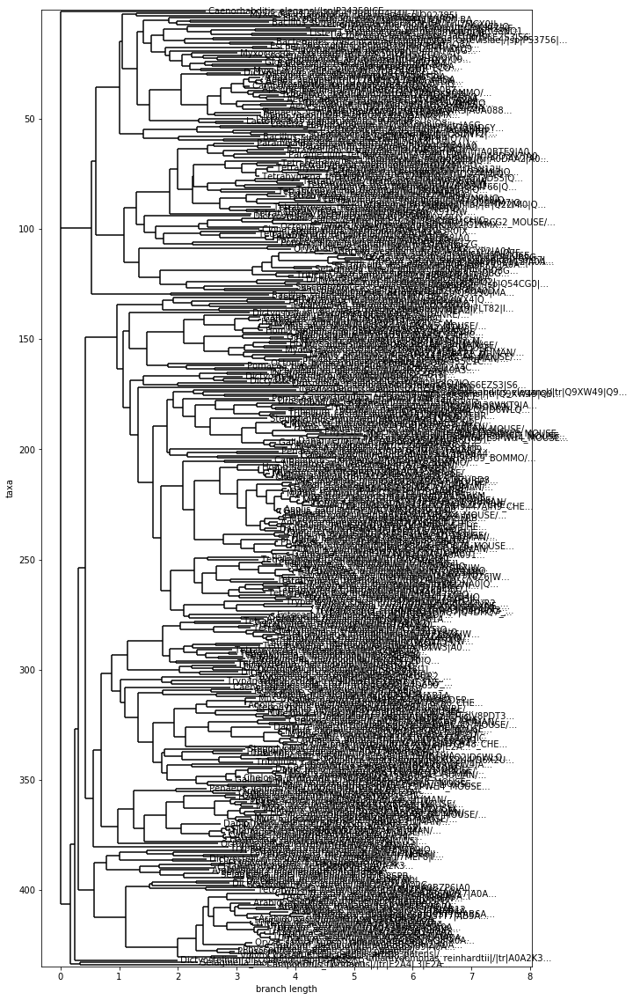

Plotting the tree file:
	ABC2_membrane_7_fasttree.nwk


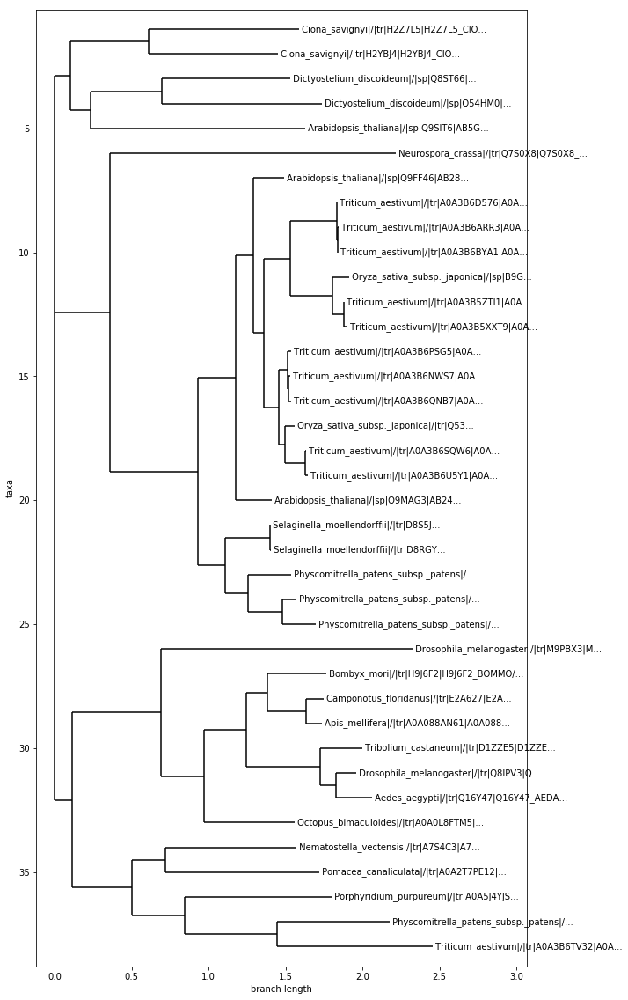

Plotting the tree file:
	ABC2_membrane_fasttree.nwk


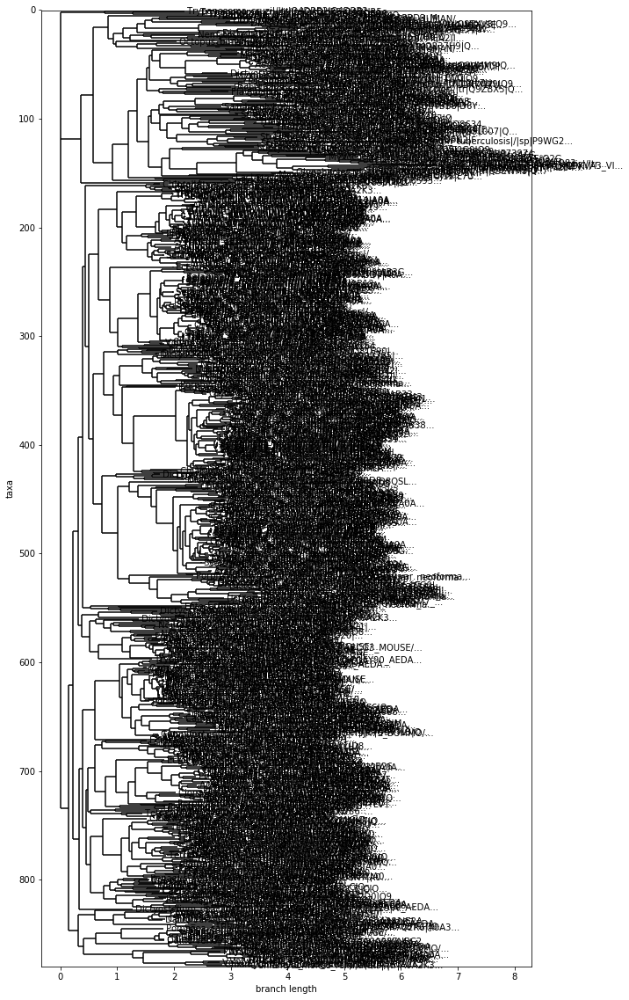

Plotting the tree file:
	ABC_membrane_fasttree.nwk


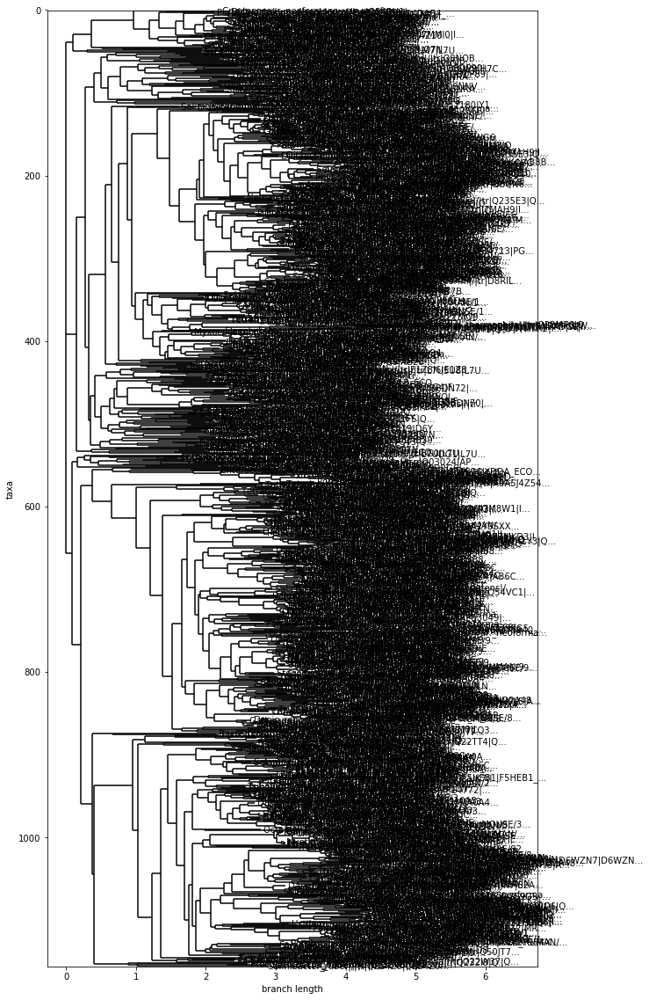

Plotting the tree file:
	ABC_tran_fasttree.nwk


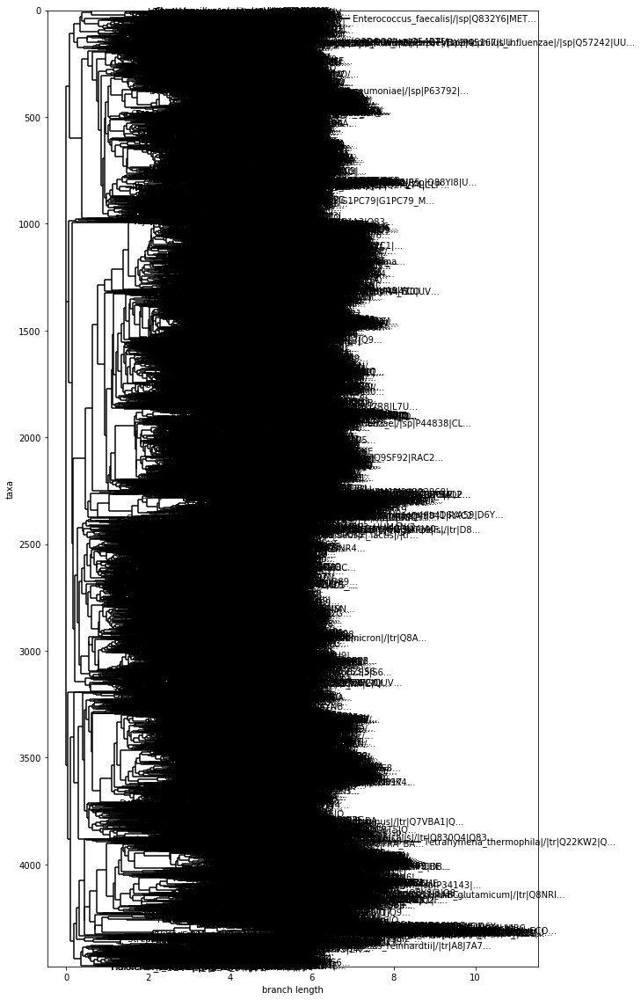

Plotting the tree file:
	BPD_transp_1_fasttree.nwk


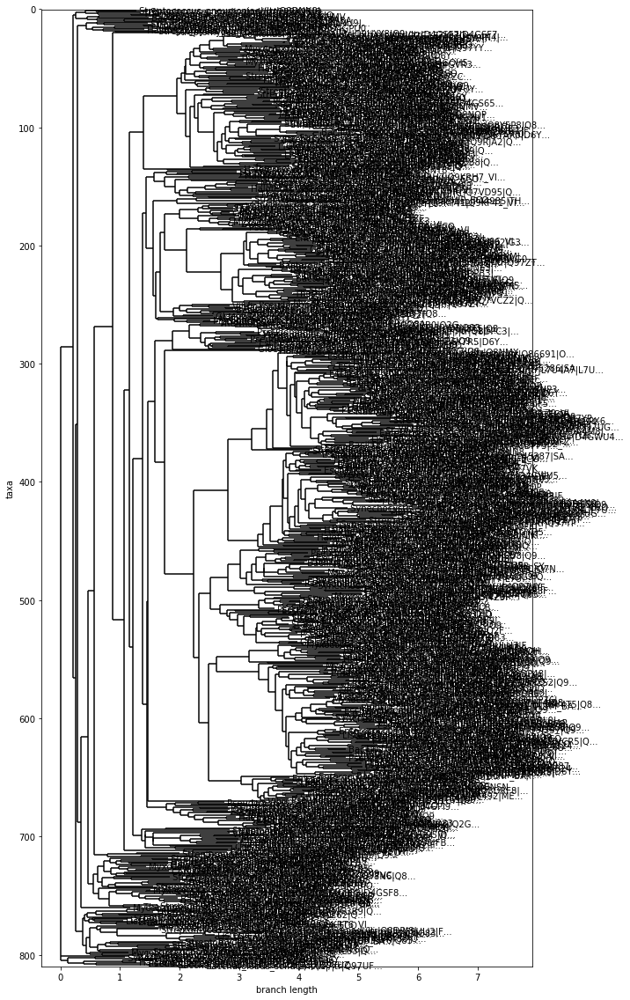

Plotting the tree file:
	BPD_transp_2_fasttree.nwk


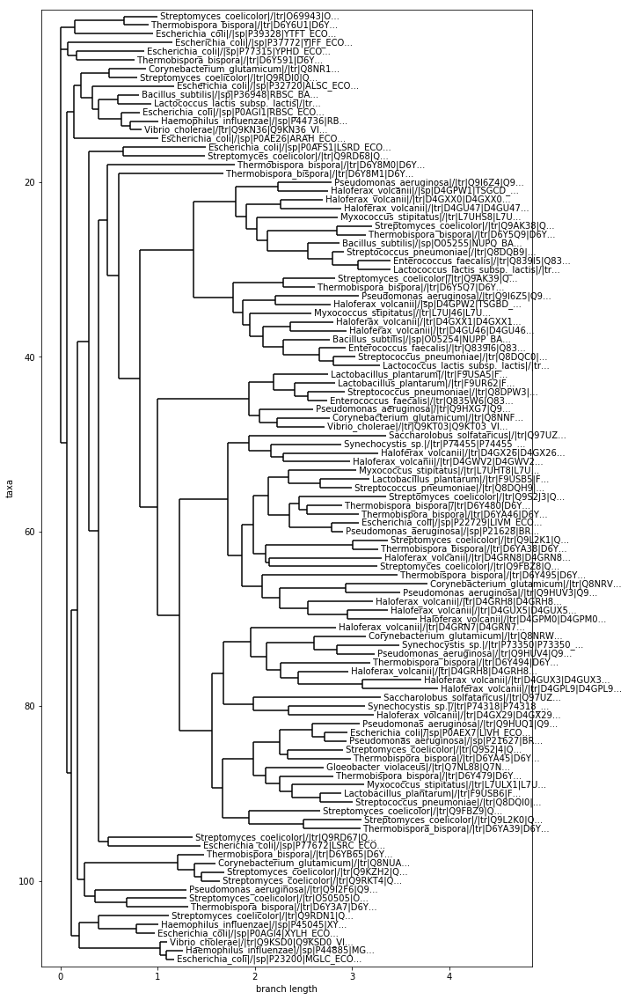

Plotting the tree file:
	FecCD_fasttree.nwk


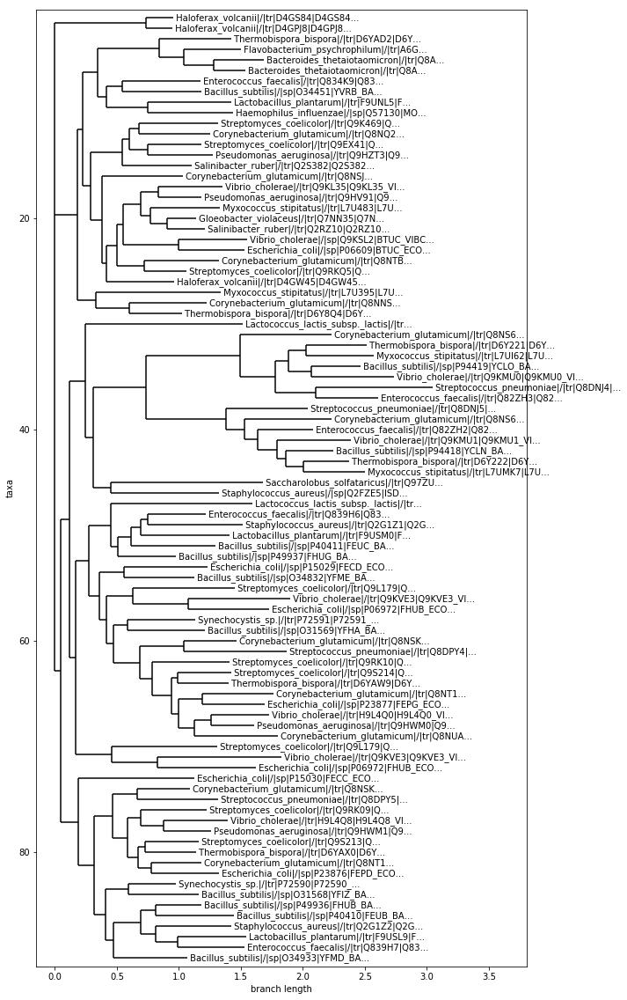

Plotting the tree file:
	FtsX_fasttree.nwk


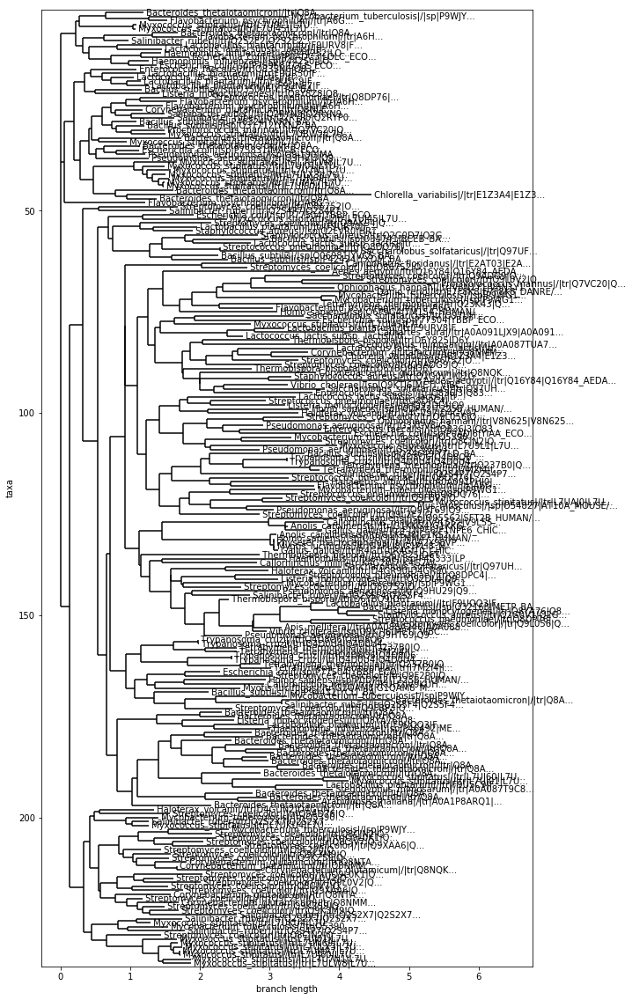

Plotting the tree file:
	PDR_CDR_fasttree.nwk


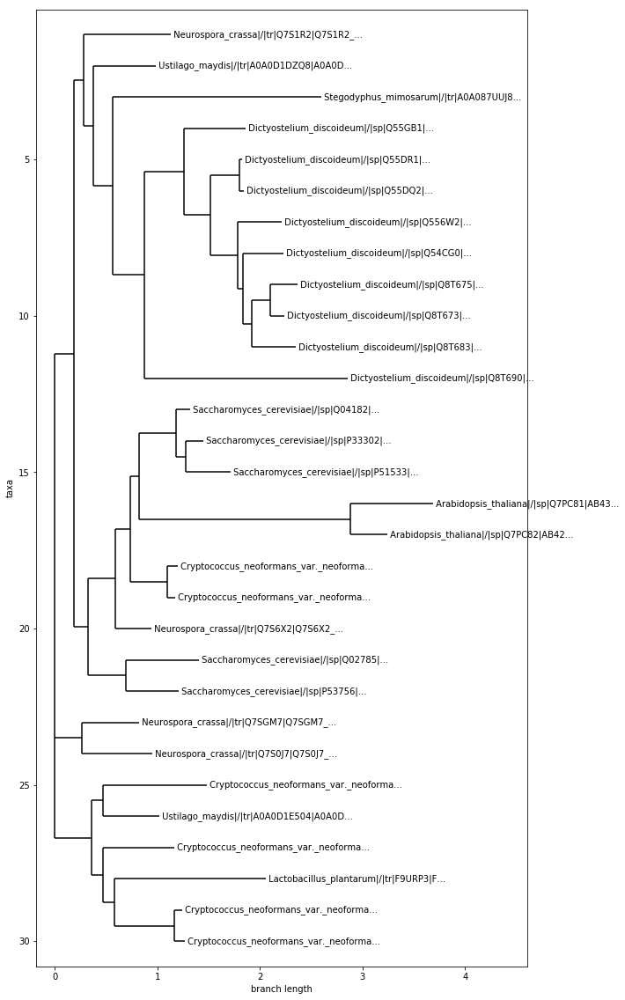

In [67]:
##Function to ingest the Newick tree file and plot the tree
##I am going to use the Bio.Phylo functions since I've been meaning to learn how to do this anyway.
###Input variables:
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###fasttree_dir = Directory containing tree files of homologous domains (stringently selected based on annotation of ABC gene) to Pfam ABC families across species.
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

fasttree_dir = os.path.join(data_dir, "tree", "fasttree_reduced-length_by-domain")
print(fasttree_dir)
fasttree_filelist = [f for f in os.listdir(fasttree_dir) if f.endswith(".nwk")]
#print(fasttree_filelist)
for fasttree_file in fasttree_filelist:
    print("\n\t".join(["Plotting the tree file:", fasttree_file]))
    protein_divergence_tree = Phylo.read(os.path.join(fasttree_dir, fasttree_file), "newick")
    #protein_divergence_tree.ladderize()
    
    #print(protein_divergence_tree)
    fig = figure(figsize=(10,20))
    ax = plt.axes()
    Phylo.draw(protein_divergence_tree, axes=ax, show_confidence=False)
    #sys.exit()

['ABC2_membrane_3_fasttree.nwk', 'ABC2_membrane_7_fasttree.nwk', 'ABC2_membrane_fasttree.nwk', 'ABC_membrane_fasttree.nwk', 'ABC_tran_fasttree.nwk', 'BPD_transp_1_fasttree.nwk', 'BPD_transp_2_fasttree.nwk', 'FecCD_fasttree.nwk', 'FtsX_fasttree.nwk', 'PDR_CDR_fasttree.nwk']
Plotting the tree file:
	../tree/fasttree_reduced-length_by-domain/BPD_transp_1_fasttree.nwk


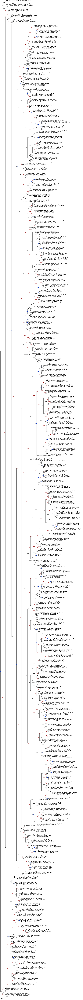

<Figure size 360x720 with 0 Axes>

In [13]:
##Function to ingest the Newick tree file and plot the tree as a test.
##I am going to use the Bio.Phylo functions since I've been meaning to learn how to do this anyway.
###Input variables:
    ###species_proteome_dictionary_file = CSV file with the details of the proteomes of species from UniProt.
    ###hmm_dictionary_file = CSV file with details of the Pfam family
    ###fasttree_dir = Directory containing tree files of homologous domains (stringently selected based on annotation of ABC gene) to Pfam ABC families across species.
species_proteome_dictionary_file = os.path.join(dictionary_dir, "20200614_UniProt_RefSeq_Proteomes_SpeciesList.csv")
species_proteome_dictionary_frame = pd.read_csv(species_proteome_dictionary_file, sep=",", index_col=False)
species_proteome_dictionary_frame.replace(to_replace='\\xa0', value=' ', inplace=True, regex=True)

hmm_dictionary_file = os.path.join(dictionary_dir, "20200616_ABC-domains_PfamMinimal-details.csv")
hmm_dictionary_frame = pd.read_csv(hmm_dictionary_file, sep=",", index_col=False)

fasttree_dir = os.path.join(data_dir, "tree", "fasttree_reduced-length_by-domain")
#fasttree_dir = os.path.join(data_dir, "tree")
fasttree_filelist = [f for f in os.listdir(fasttree_dir) if (f.endswith(".newick") or f.endswith(".nwk"))]
print(fasttree_filelist)

fasttree_file = os.path.join(fasttree_dir, "BPD_transp_1_fasttree.nwk")

print("\n\t".join(["Plotting the tree file:", fasttree_file]))
#protein_divergence_tree = Phylo.read(os.path.join(fasttree_dir, fasttree_file), "newick")
protein_divergence_tree = Tree(fasttree_file)

####Styling an ete3.Tree instance.
ts = TreeStyle()
ts.show_leaf_name = True
ts.show_branch_length = True
ts.show_branch_support = True
ts.branch_vertical_margin = 10 # 10 pixels between adjacent branches

#print(protein_divergence_tree)
fig = figure(figsize=(5,10))
#ax = plt.axes()
protein_divergence_tree.render("%%inline", tree_style=ts)


#sys.exit()

### Results of tree plotting
1. I am using the ete3 library that is pretty good for the visualization of protein divergence trees.
2. I think I finally have all the sequence collections the way I want them. I am going to work on the text more for now and will then come back to the figures to plot the distribution of different transporter types for the NBD tree and the species distribution for all the trees.

## Binaries used in this notebook

In [12]:
from platform import python_version

print(python_version())

2.7.18


In [8]:
cmd = 'hmmsearch -h'
!{cmd}

# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Usage: hmmsearch [options] <hmmfile> <seqdb>

Basic options:
  -h : show brief help on version and usage

Options directing output:
  -o <f>           : direct output to file <f>, not stdout
  -A <f>           : save multiple alignment of all hits to file <f>
  --tblout <f>     : save parseable table of per-sequence hits to file <f>
  --domtblout <f>  : save parseable table of per-domain hits to file <f>
  --pfamtblout <f> : save table of hits and domains to file, in Pfam format <f>
  --acc            : prefer accessions over names in output
  --noali          : don't output alignments, so output is smaller
  --notextw        : unlimit ASCII text output line width
  --textw <n>      : set max width of AS

In [32]:
cmd = 'esl-sfetch -h'
!{cmd}

# esl-sfetch :: retrieve sequence(s) from a file
# Easel 0.46 (Nov 2019)
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Usage: esl-sfetch [options] <sqfile> <name>        (one seq named <name>)
Usage: esl-sfetch [options] -f <sqfile> <namefile> (all seqs in <namefile>)
Usage: esl-sfetch [options] --index <sqfile>       (index <sqfile>)

 where general options are:
  -h     : help; show brief info on version and usage
  -o <f> : output sequences to file <f> instead of stdout
  -O     : output sequence to file named <key>
  -n <s> : rename the sequence <s>
  -r     : reverse complement the seq(s)

 Options for retrieving subsequences:
  -c <s> : retrieve subsequence coords <from>..<to>
  -C     : <namefile> in <f> contains subseq coords too

  On command line, subseq coords are separated by any nonnumeric, nonspace character(s).
  for example, -c 23..10

In [72]:
cmd = 'hmmalign -h'
!{cmd}

# hmmalign :: align sequences to a profile HMM
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Usage: hmmalign [-options] <hmmfile> <seqfile>

Basic options:
  -h     : show brief help on version and usage
  -o <f> : output alignment to file <f>, not stdout

Less common options:
  --mapali <f>    : include alignment in file <f> (same ali that HMM came from)
  --trim          : trim terminal tails of nonaligned residues from alignment
  --amino         : assert <seqfile>, <hmmfile> both protein: no autodetection
  --dna           : assert <seqfile>, <hmmfile> both DNA: no autodetection
  --rna           : assert <seqfile>, <hmmfile> both RNA: no autodetection
  --informat <s>  : assert <seqfile> is in format <s>: no autodetection
  --outformat <s> : output alignment in format <s>  [Stockholm]

Sequence input for

In [5]:
cmd = 'esl-reformat -h'
!{cmd}

# esl-reformat :: convert between sequence file formats
# Easel 0.46 (Nov 2019)
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Usage: esl-reformat [-options] <format> <seqfile>
  Output format choices: Unaligned      Aligned    
                         -----------    -------    
                         fasta          a2m        
                         hmmpgmd        afa        
                                        clustal    
                                        clustallike
                                        pfam       
                                        phylip     
                                        phylips    
                                        psiblast   
                                        selex      
                                        stockholm  


  where options are:

  -d             : convert to DNA alph

In [8]:
cmd = 'FastTree -h'
!{cmd}

Unknown or incorrect use of option -h
  FastTree protein_alignment > tree
  FastTree < protein_alignment > tree
  FastTree -out tree protein_alignment
  FastTree -nt nucleotide_alignment > tree
  FastTree -nt -gtr < nucleotide_alignment > tree
  FastTree < nucleotide_alignment > tree
FastTree accepts alignments in fasta or phylip interleaved formats

Common options (must be before the alignment file):
  -quiet to suppress reporting information
  -nopr to suppress progress indicator
  -log logfile -- save intermediate trees, settings, and model details
  -fastest -- speed up the neighbor joining phase & reduce memory usage
        (recommended for >50,000 sequences)
  -n <number> to analyze multiple alignments (phylip format only)
        (use for global bootstrap, with seqboot and CompareToBootstrap.pl)
  -nosupport to not compute support values
  -intree newick_file to set the starting tree(s)
  -intree1 newick_file to use this starting tree for all the alignments
        (for faster 

In [9]:
cmd = 'phyml -h'
!{cmd}

--------------------------------------------------------------------------
btl_vader_single_copy_mechanism MCA variable, but CMA support is
not available due to restrictive ptrace settings.

The vader shared memory BTL will fall back on another single-copy
mechanism if one is available. This may result in lower performance.

  Local host: SriXPS15
--------------------------------------------------------------------------

. Command line: /usr/lib/phyml/bin/phyml-mpi -h 
NAME
	- PhyML 3.3.3:3.3.20170530+dfsg-2 - 

	''A simple, fast, and accurate algorithm to estimate
	large phylogenies by maximum likelihood''

	Stephane Guindon and Olivier Gascuel,
	Systematic Biology 52(5):696-704, 2003.

	Please cite this paper if you use this software in your publications.

SYNOPSIS:

	phyml [command args]

	All the options below are optional (except '-i' if you want to use the command-line interface).


Command options:

	-i (or --input) seq_file_name
		seq_file_name is the name of the nucleotide or